<a href="https://colab.research.google.com/github/arthurw125/GAN_Research/blob/main/AC_CycleGAN_MultCycle_3to1_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Uses 3 Camera Views to Reproduce the Missing 4th Camera View (1 Generator and 1 Discriminator). Uses AC-GAN, V2 uses Conv2d and adds 3 Cam Vecs for Input

## Setup

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
!pip install tensorflow_addons
import tensorflow_addons as tfa
import tensorflow_datasets as tfds

tfds.disable_progress_bar()
autotune = tf.data.AUTOTUNE

import json
import cv2
from keras.utils.vis_utils import plot_model

     |████████████████████████████████| 1.1 MB 14.2 MB/s 


In [ ]:
class DataReader:

    def __init__(self, image_dir, label_dir, num_cam, start_frame=0, end_frame=0, save_videos=False):
        self._image_dir = image_dir
        self._label_dir = label_dir
        self._num_cam = num_cam
        self._start_frame = start_frame
        self._end_frame = end_frame
        self._save_videos = save_videos

        if self._save_videos:
            self._rgb_videos = {}
            for cam_id in range(1, self._num_cam+1):
                self._rgb_videos[cam_id] = cv2.VideoWriter('video_camera_view_'+str(cam_id)+'.avi', cv2.VideoWriter_fourcc(*'MJPG'), 15, (640, 360))
                #self._rgb_videos[cam_id] = cv2.VideoWriter('video_camera_view_'+str(cam_id)+'.mp4', cv2.VideoWriter_fourcc(*'mp4v'), 15, (640, 360))
                #self._rgb_videos[cam_id] = cv2.VideoWriter('video_camera_view_'+str(cam_id)+'.mov', cv2.VideoWriter_fourcc(*'H264'), 15, (640, 360))
    def __del__(self):
        if self._save_videos:
            for _, out_video in self._rgb_videos.items():
                out_video.release()

    def read(self, frame_id):
        rgbs = {}
        labels = {}
        for cam_id in range(1, self._num_cam+1):
            rgb = cv2.imread(os.path.join(self._image_dir, 'rgb_'+str(frame_id).zfill(5)+'_'+str(cam_id)+'.jpg'), cv2.IMREAD_UNCHANGED)
            label = json.load(open(os.path.join(self._label_dir, 'rgb_'+str(frame_id).zfill(5)+'_'+str(cam_id)+'.json')))
            rgbs[cam_id] = rgb
            labels[cam_id] = label

        return rgbs, labels
    
    def plot(self):
        for frame_id in range(self._start_frame, self._end_frame):
            rgbs, labels = self.read(frame_id)
            for cam_id in range(1, self._num_cam+1):
                rgb = rgbs[cam_id]
                tracklet = labels[cam_id]
                '''
                //code for adding bounding box around the people
                for id, (x_min, y_min, x_max, y_max) in tracklet.items():
                    rgb = cv2.rectangle(rgb, (int(x_min), int(y_min)), (int(x_max), int(y_max)), (0, 0, 255), 2)
                    rgb = cv2.putText(rgb, str(id), (int(x_min), int(y_min)), cv2.FONT_HERSHEY_PLAIN, 2, (0, 255, 0), 2, cv2.LINE_AA)
                rgb = cv2.putText(rgb, str(frame_id), (30, 30), cv2.FONT_HERSHEY_PLAIN, 1, (255, 255, 0), 2, cv2.LINE_AA)
                '''
                if self._save_videos:
                    self._rgb_videos[cam_id].write(rgb)

In [ ]:
def img_seq_resize(data, start, end):
  rows = []
  for i in range(start,end):
    img = tf.image.resize(data[:,i,...], [100, 100],preserve_aspect_ratio=True,method=tf.image.ResizeMethod.BILINEAR)
    rows.append(img)
  img_seq = tf.stack(rows, axis=1)
  return img_seq

In [ ]:
def create_dataset(image_dir, label_dir, num_cam, start_frame, end_frame):
    my_data = []
    my_labels = []
    count = 0
    data_reader = DataReader(image_dir, label_dir, num_cam, start_frame, end_frame, False)
    for frame_id in range(start_frame, end_frame):
        data, labels = data_reader.read(frame_id)
        my_list = list(data.values())
        my_list = np.array(my_list)
        my_data.append(my_list)
        my_labels.append(labels)
        if count % 100 == 0:
          print('frame_id:',frame_id)
        count += 1
    my_data = np.array(my_data)
    my_labels = np.array(my_labels)
    cyc_data = {'A': tf.data.Dataset.from_tensor_slices(img_seq_resize(my_data, 0, 3)),
                'B': tf.data.Dataset.from_tensor_slices(img_seq_resize(my_data, 3, 4))}
  
    return cyc_data, my_labels 

## Prepare the dataset



In [ ]:

image_dir = '/content/drive/MyDrive/Research/train/images/63am/cafe_shop_0'
label_dir = '/content/drive/MyDrive/Research/train/labels/63am/cafe_shop_0'
num_cam = 4

start_frame, end_frame = 0, 1000
dataset_train, _ = create_dataset(image_dir, label_dir, num_cam, start_frame, end_frame)
#dataset_train = tf.data.Dataset.from_tensor_slices(dataset_train)
start_frame, end_frame = 1000, 1200
dataset_test, _ = create_dataset(image_dir, label_dir, num_cam, start_frame, end_frame)
#dataset_test = tf.data.Dataset.from_tensor_slices(dataset_test)


frame_id: 0
frame_id: 100
frame_id: 200
frame_id: 300
frame_id: 400
frame_id: 500
frame_id: 600
frame_id: 700
frame_id: 800
frame_id: 900
frame_id: 1000
frame_id: 1100


In [ ]:
print(dataset_train)
print(dataset_test)
train_angles_3, train_angles_1 = dataset_train['A'], dataset_train['B']
test_angles_3, test_angles_1 = dataset_test['A'], dataset_test['B']
# Define the standard image size.
orig_img_size = (360, 640)
# Size of the random crops to be used during training.
input_img_size = (45, 80, 3)
# Weights initializer for the layers.
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

#buffer_size = 256
buffer_size = 256
#batch_size = 16


def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    # Map values in the range [-1, 1]
    return (img / 127.5) - 1.0


def preprocess_train_image(img):
    # Random flip
    #img = tf.image.random_flip_left_right(img)
    # Resize to the original size first
    #img = tf.image.resize(img, [*orig_img_size])
    # Random crop to 256X256
    #img = tf.image.random_crop(img, size=[*input_img_size])
    # Normalize the pixel values in the range [-1, 1]
    img = normalize_img(img)
    return img


def preprocess_test_image(img):
    # Only resizing and normalization for the test images.
    #img = tf.image.resize(img, [input_img_size[0], input_img_size[1]])
    img = normalize_img(img)
    return img


{'A': <TensorSliceDataset shapes: (3, 56, 100, 3), types: tf.float32>, 'B': <TensorSliceDataset shapes: (1, 56, 100, 3), types: tf.float32>}
{'A': <TensorSliceDataset shapes: (3, 56, 100, 3), types: tf.float32>, 'B': <TensorSliceDataset shapes: (1, 56, 100, 3), types: tf.float32>}


In [ ]:
dataset_train['A']
# original img size (360, 640, 3)

<TensorSliceDataset shapes: (3, 56, 100, 3), types: tf.float32>

In [ ]:
dataset_train['B']

<TensorSliceDataset shapes: (1, 56, 100, 3), types: tf.float32>

## Create `Dataset` objects

In [ ]:
#train_angles_3.shape, train_angles_1.shape

In [ ]:
batch_size = 32

In [ ]:

train_angles_3 = (
    train_angles_3.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
train_angles_1 = (
    train_angles_1.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

# Apply the preprocessing operations to the test data
test_angles_3 = (
    test_angles_3.map(preprocess_test_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
test_angles_1 = (
    test_angles_1.map(preprocess_test_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)


## Visualize some samples

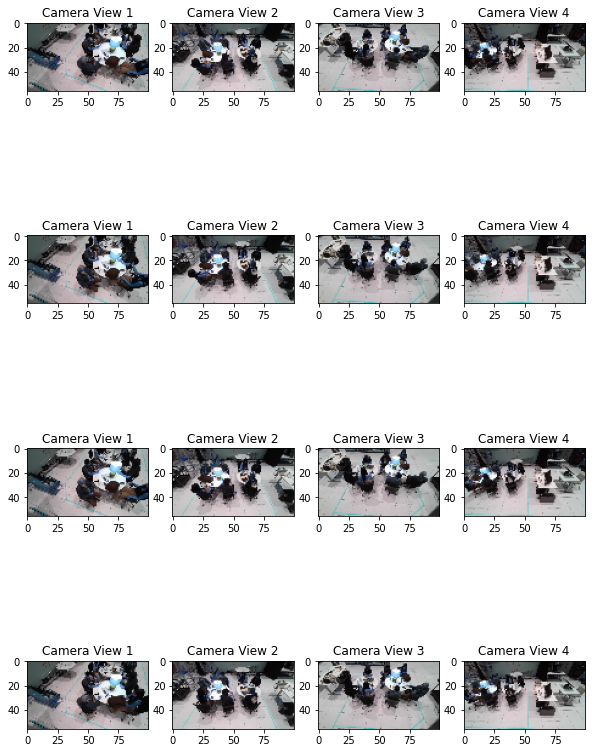

In [ ]:

_, ax = plt.subplots(4, 4, figsize=(10, 15))
for i, samples in enumerate(zip(train_angles_3.take(4), train_angles_1.take(4))):
    cam1 = (((samples[0][0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cam2 = (((samples[0][0][1] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cam3 = (((samples[0][0][2] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cam4 = (((samples[1][0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    #ax[i, 0].imshow(samples[0][0])
    #ax[i, 1].imshow(samples[1][0])
    ax[i, 0].imshow(cam1)
    ax[i, 1].imshow(cam2)
    ax[i, 2].imshow(cam3)
    ax[i, 3].imshow(cam4)
    ax[i, 0].set_title("Camera View 1")
    ax[i, 1].set_title("Camera View 2")
    ax[i, 2].set_title("Camera View 3")
    ax[i, 3].set_title("Camera View 4")
plt.show()


## Building blocks used in the CycleGAN generators and discriminators

In [ ]:

class ReflectionPadding2D(layers.Layer):
    """Implements Reflection Padding as a layer.

    Args:
        padding(tuple): Amount of padding for the
        spatial dimensions.

    Returns:
        A padded tensor with the same type as the input tensor.
    """

    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        super(ReflectionPadding2D, self).__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        return tf.pad(input_tensor, padding_tensor, mode="REFLECT")


def residual_block(
    x,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(1, 1),
    padding="valid",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.add([input_tensor, x])
    return x


def downsample(
    x,
    filters,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2D(
        filters,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


def upsample(
    x,
    filters,
    activation,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    kernel_initializer=kernel_init,
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2DTranspose(
        filters,
        kernel_size,
        strides=strides,
        padding=padding,
        kernel_initializer=kernel_initializer,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


## Build the generators

In [ ]:

def get_resnet_generator(
    filters=64,
    num_downsampling_blocks=2,
    num_residual_blocks=9,
    num_upsample_blocks=2,
    gamma_initializer=gamma_init,
    name=None,
    input_img_size=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = ReflectionPadding2D(padding=(3, 3))(img_input)
    x = layers.Conv2D(filters, (7, 7), kernel_initializer=kernel_init, use_bias=False)(
        x
    )
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.Activation("relu")(x)

    # Downsampling
    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(x, filters=filters, activation=layers.Activation("relu"))

    # Residual blocks
    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation("relu"))

    # Upsampling
    for _ in range(num_upsample_blocks):
        filters //= 2
        x = upsample(x, filters, activation=layers.Activation("relu"))

    # Final block
    x = ReflectionPadding2D(padding=(3, 3))(x)
    x = layers.Conv2D(3, (7, 7), padding="valid")(x)
    x = layers.Activation("tanh")(x)

    model = keras.models.Model(img_input, x, name=name)
    return model


## Build the discriminators

In [ ]:

def get_discriminator(
    filters=64, 
    kernel_initializer=kernel_init, 
    num_downsampling=3, 
    name=None,
    input_img_size=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = layers.Conv2D(
        filters,
        (4, 4),
        strides=(2, 2),
        padding="same",
        kernel_initializer=kernel_initializer,
    )(img_input)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(1, 1),
            )

    x = layers.Conv2D(
        1, (4, 4), strides=(1, 1), padding="same", kernel_initializer=kernel_initializer
    )(x)
    x = layers.Flatten()(x)
    real_fake = layers.Dense(1, activation='sigmoid')(x)
    my_class = layers.Dense(4, activation='softmax')(x)
    #model = keras.models.Model(inputs=img_input, outputs=x, name=name)
    model = keras.models.Model(inputs=img_input, outputs=[real_fake,my_class], name=name)
    
    return model

In [ ]:
# Get the generators

gen_X = get_resnet_generator(name="generator", input_img_size=(56, 100, 3))

# Get the discriminators

disc_X = get_discriminator(name="discriminator", input_img_size=(56, 100, 3))


In [ ]:
gen_X.summary()

Model: "generator"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 generator_img_input (InputLaye  [(None, 56, 100, 3)  0          []                               
 r)                             ]                                                                 
                                                                                                  
 reflection_padding2d_1 (Reflec  (None, 62, 106, 3)  0           ['generator_img_input[0][0]']    
 tionPadding2D)                                                                                   
                                                                                                  
 conv2d (Conv2D)                (None, 56, 100, 64)  9408        ['reflection_padding2d_1[0][0]'] 
                                                                                          

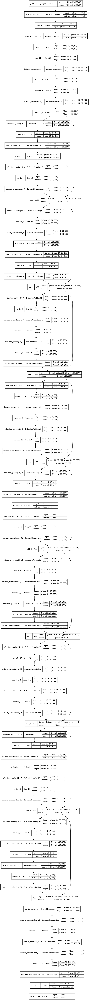

In [ ]:
plot_model(gen_X, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
disc_X.summary()

Model: "discriminator"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 discriminator_img_input (Input  [(None, 56, 100, 3)  0          []                               
 Layer)                         ]                                                                 
                                                                                                  
 conv2d_22 (Conv2D)             (None, 28, 50, 64)   3136        ['discriminator_img_input[0][0]']
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 28, 50, 64)   0           ['conv2d_22[0][0]']              
                                                                                                  
 conv2d_23 (Conv2D)             (None, 14, 25, 128)  131072      ['leaky_re_lu[0][0]']

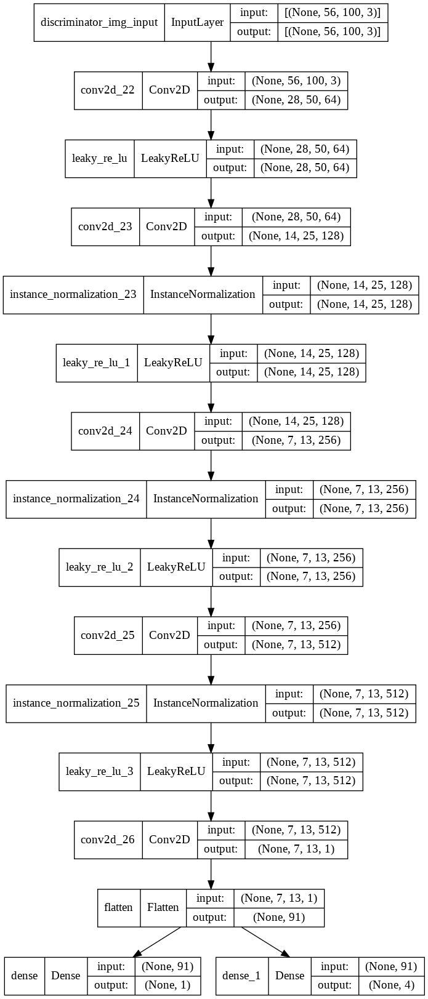

In [ ]:
plot_model(disc_X, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True)

## Build the CycleGAN model

We will override the `train_step()` method of the `Model` class
for training via `fit()`.

In [ ]:
from tensorflow.keras.utils import to_categorical

In [ ]:

class CycleGan(keras.Model):
    def __init__(
        self,
        generator_X,
        discriminator_X,
        lambda_cycle=10.0,
        lambda_identity=0.5,
    ):
        super(CycleGan, self).__init__()
        self.gen = generator_X
        self.disc = discriminator_X
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def compile(
        self,
        gen_X_optimizer,
        disc_X_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super(CycleGan, self).compile()
        self.gen_X_optimizer = gen_X_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = keras.losses.MeanAbsoluteError()
        self.identity_loss_fn = keras.losses.MeanAbsoluteError()

    def train_step(self, batch_data):
        
        real_x, real_z, train_class = batch_data
        real_z = real_z[:,0,...]
        #print('shape:',real_z.shape)
        real_w,real_x,real_y = real_x[:,0,:,:,:],real_x[:,1,:,:,:],real_x[:,2,:,:,:]
        w,x,y,z = train_class[:,0,...],train_class[:,1,...],train_class[:,2,...],train_class[:,3,...]
        
        true_labels = {'w':w, 'x':x, 'y':y, 'z':z}
        # For CycleGAN, we need to calculate different
        # kinds of losses for the generators and discriminators.
        # We will perform the following steps here:
        #
        # 1. Pass real images through the generators and get the generated images
        # 2. Pass the generated images back to the generators to check if we
        #    we can predict the original image from the generated image.
        # 3. Do an identity mapping of the real images using the generators.
        # 4. Pass the generated images in 1) to the corresponding discriminators.
        # 5. Calculate the generators total loss (adverserial + cycle + identity)
        # 6. Calculate the discriminators loss
        # 7. Update the weights of the generators
        # 8. Update the weights of the discriminators
        # 9. Return the losses in a dictionary

        with tf.GradientTape(persistent=True) as tape:
            
            # w,x,y -> z'
            input1 = tf.add_n([real_w,real_x,real_y])
            #print("input1",input1.shape)
            fake_z = self.gen(input1, training=True)
            # x,y,z -> w'
            input2 = tf.add_n([real_x,real_y,real_z])
            #print("input2",input2.shape)
            fake_w = self.gen(input2, training=True)
            # y,z,w -> x'
            input3 = tf.add_n([real_y,real_z,real_w])
            #print("input3",input3.shape)
            fake_x = self.gen(input3, training=True)
            # z,w,x -> y'
            input4 = tf.add_n([real_z,real_w,real_x])
            #print("input4",input4.shape)
            fake_y = self.gen(input4, training=True)
            
            # w',x',y' -> z''
            input11 = tf.add_n([fake_w,fake_x,fake_y])
            #print("input11",input11.shape)
            fake_zz = self.gen(input11, training=True)
            # x',y',z' -> w''
            input22 = tf.add_n([fake_x,fake_y,fake_z])
            #print("input22",input22.shape)
            fake_ww = self.gen(input22, training=True)
            # y',z',w' -> x''
            input33 = tf.add_n([fake_y,fake_z,fake_w])
            #print("input33",input33.shape)
            fake_xx = self.gen(input33, training=True)
            # z',w',x' -> y''
            input44 = tf.add_n([fake_z,fake_w,fake_x])
            #print("input44",input44.shape)
            fake_yy = self.gen(input44, training=True)
            # Identity mapping
            #same_x = self.gen_F(real_x, training=True)
            #same_y = self.gen_G(real_y, training=True)

            
            # Discriminator output
            '''
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)
            '''
            disc_real_x, real_label_x = self.disc(real_x, training=True)
            disc_fake_x, fake_label_x = self.disc(fake_x, training=True)

            disc_real_y, real_label_y = self.disc(real_y, training=True)
            disc_fake_y, fake_label_y = self.disc(fake_y, training=True)

            disc_real_z, real_label_z = self.disc(real_z, training=True)
            disc_fake_z, fake_label_z = self.disc(fake_z, training=True)

            disc_real_w, real_label_w = self.disc(real_w, training=True)
            disc_fake_w, fake_label_w = self.disc(fake_w, training=True)

            # Generator adverserial loss
            
            gen_X_loss = self.generator_loss_fn(disc_fake_x, fake_label_x, true_labels['x'])
            gen_Y_loss = self.generator_loss_fn(disc_fake_y, fake_label_y, true_labels['y'])
            gen_Z_loss = self.generator_loss_fn(disc_fake_z, fake_label_z, true_labels['z'])
            gen_W_loss = self.generator_loss_fn(disc_fake_w, fake_label_w, true_labels['w'])
            # Generator cycle loss
            
            cycle_loss_X = self.cycle_loss_fn(real_x, fake_xx) * self.lambda_cycle
            cycle_loss_Y = self.cycle_loss_fn(real_y, fake_yy) * self.lambda_cycle
            cycle_loss_Z = self.cycle_loss_fn(real_z, fake_zz) * self.lambda_cycle
            cycle_loss_W = self.cycle_loss_fn(real_w, fake_ww) * self.lambda_cycle
            # Generator identity loss
            '''
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )
            '''
            # Total generator loss
      
            total_loss_X = gen_X_loss + cycle_loss_X# + id_loss_G
            total_loss_Y = gen_Y_loss + cycle_loss_Y# + id_loss_F
            total_loss_Z = gen_Z_loss + cycle_loss_Z# + id_loss_G
            total_loss_W = gen_W_loss + cycle_loss_W# + id_loss_F
            total_loss = total_loss_X + total_loss_Y + total_loss_Z + total_loss_W
            # Discriminator loss

            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x, real_label_x, fake_label_x, true_labels["x"])
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y, real_label_y, fake_label_y, true_labels["y"])
            disc_Z_loss = self.discriminator_loss_fn(disc_real_z, disc_fake_z, real_label_z, fake_label_z, true_labels["z"])
            disc_W_loss = self.discriminator_loss_fn(disc_real_w, disc_fake_w, real_label_w, fake_label_w, true_labels["w"])
            disc_loss = disc_X_loss + disc_Y_loss + disc_Z_loss + disc_W_loss
        # Get the gradients for the generator

        grads = tape.gradient(total_loss, self.gen.trainable_variables)
        
        # Get the gradients for the discriminators

        disc_grads = tape.gradient(disc_loss, self.disc.trainable_variables)
        
        # Update the weights of the generators
        
        self.gen_X_optimizer.apply_gradients(
            zip(grads, self.gen.trainable_variables)
        )
        
        # Update the weights of the discriminators
        
        self.disc_X_optimizer.apply_gradients(
            zip(disc_grads, self.disc.trainable_variables)
        )
        
        return {
            "X_loss": total_loss_X,
            "Y_loss": total_loss_Y,
            "Z_loss": total_loss_Z,
            "W_loss": total_loss_W,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
            "D_Z_loss": disc_Z_loss,
            "D_W_loss": disc_W_loss,
        }

## Create a callback that periodically saves generated images

In [ ]:
class GANMonitor(keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        _, ax = plt.subplots(4, 4, figsize=(15, 15))
        for i, img in enumerate(test_angles_3.take(self.num_img)):
            real_w,real_x,real_y = img[:,0,:,:,:],img[:,1,:,:,:],img[:,2,:,:,:]
            input1 = tf.add_n([real_w,real_x,real_y])
            prediction = self.model.gen(input1)[0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            img1 = (img[0][0] * 127.5 + 127.5).numpy().astype(np.uint8)
            img2 = (img[0][1] * 127.5 + 127.5).numpy().astype(np.uint8)
            img3 = (img[0][2] * 127.5 + 127.5).numpy().astype(np.uint8)
            
            ax[i, 0].imshow(img1)
            ax[i, 1].imshow(img2)
            ax[i, 2].imshow(img3)
            ax[i, 3].imshow(prediction)

            ax[i, 0].set_title("Input image")
            ax[i, 1].set_title("Input image")
            ax[i, 2].set_title("Input image")
            ax[i, 3].set_title("Translated image")
            ax[i, 0].axis("off")
            ax[i, 1].axis("off")
            ax[i, 2].axis("off")
            ax[i, 3].axis("off")

            prediction = keras.preprocessing.image.array_to_img(prediction)
            prediction.save(
                "/content/drive/MyDrive/Research/CycleGAN_imgs/generated_img_{i}_{epoch}.png".format(i=i, epoch=epoch + 1)
            )
        plt.show()
        plt.close()

In [ ]:
def create_labels(size):
  w,x,y,z = size*[0],size*[1],size*[2],size*[3]
  w,x,y,z = (to_categorical(w, num_classes=4),to_categorical(x, num_classes=4), #one-hot encode labels 
    to_categorical(y, num_classes=4),to_categorical(z, num_classes=4))
  #true_labels = {'w':w, 'x':x, 'y':y, 'z':z}
  true_labels = tf.stack([w,x,y,z], axis=1)
  
  return true_labels

In [ ]:
a_test = create_labels(10)

In [ ]:
a_test.shape

TensorShape([10, 4, 4])

In [ ]:
a_test[1]

<tf.Tensor: shape=(4, 4), dtype=float32, numpy=
array([[1., 0., 0., 0.],
       [0., 1., 0., 0.],
       [0., 0., 1., 0.],
       [0., 0., 0., 1.]], dtype=float32)>

In [ ]:
class_labels = create_labels(1000)
my_labels = tf.data.Dataset.from_tensor_slices(class_labels)

In [ ]:
my_labels

<TensorSliceDataset shapes: (4, 4), types: tf.float32>

In [ ]:
train_labels = (
    my_labels
    .cache()
    .batch(batch_size)
)

In [ ]:
train_labels

<BatchDataset shapes: (None, 4, 4), types: tf.float32>

In [ ]:
len(list(train_labels.as_numpy_iterator())[0])

32

## Train the end-to-end model

Epoch 1/50
32/32 [==============================] - ETA: 0s - X_loss: 7.3291 - Y_loss: 7.2532 - Z_loss: 6.8186 - W_loss: 7.0536 - D_X_loss: 0.7209 - D_Y_loss: 0.6968 - D_Z_loss: 0.5234 - D_W_loss: 0.7785

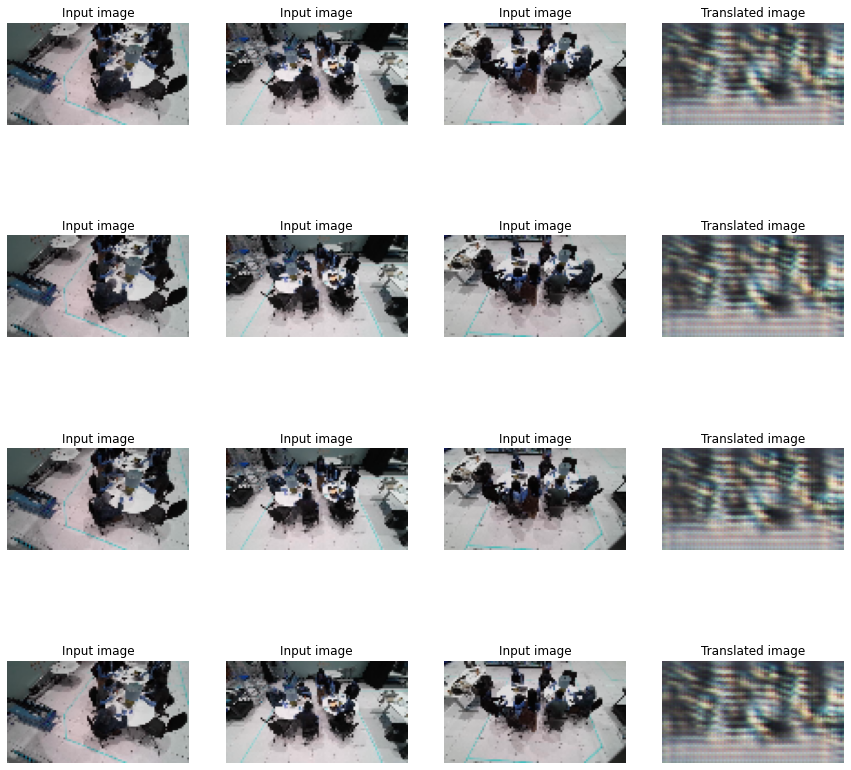

32/32 [==============================] - 100s 823ms/step - X_loss: 7.2737 - Y_loss: 7.2069 - Z_loss: 6.7580 - W_loss: 7.0115 - D_X_loss: 0.7112 - D_Y_loss: 0.6951 - D_Z_loss: 0.5264 - D_W_loss: 0.7742
Epoch 2/50
32/32 [==============================] - ETA: 0s - X_loss: 6.1747 - Y_loss: 6.7320 - Z_loss: 5.9401 - W_loss: 6.3984 - D_X_loss: 0.8303 - D_Y_loss: 0.8941 - D_Z_loss: 0.8928 - D_W_loss: 0.9737

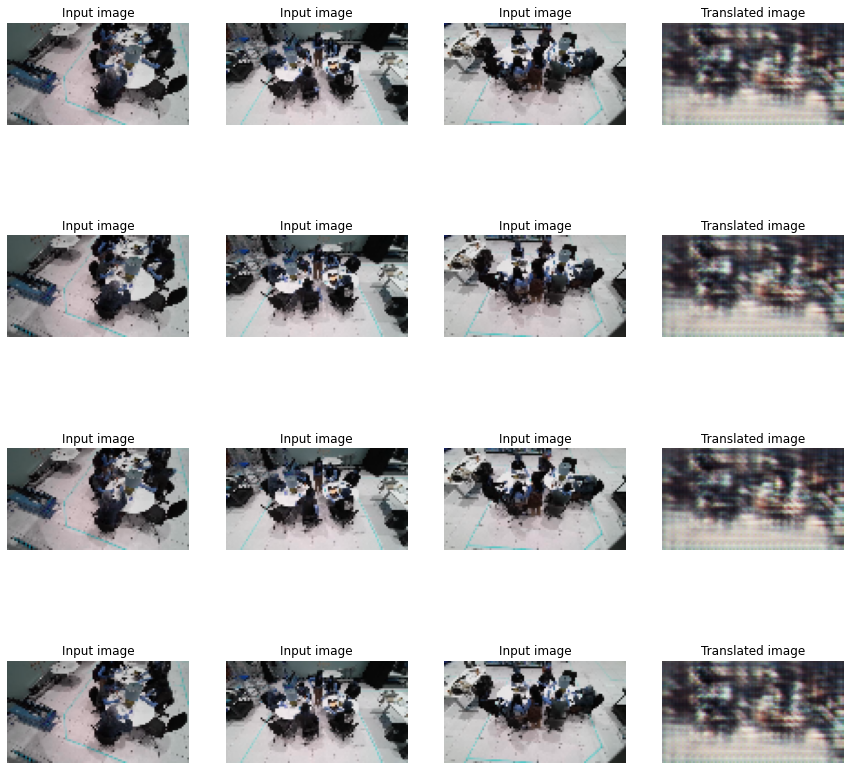

32/32 [==============================] - 22s 698ms/step - X_loss: 6.1479 - Y_loss: 6.7084 - Z_loss: 5.9026 - W_loss: 6.3721 - D_X_loss: 0.8235 - D_Y_loss: 0.8833 - D_Z_loss: 0.8791 - D_W_loss: 0.9688
Epoch 3/50
32/32 [==============================] - ETA: 0s - X_loss: 6.1504 - Y_loss: 6.7067 - Z_loss: 5.7887 - W_loss: 6.4863 - D_X_loss: 1.0368 - D_Y_loss: 0.9658 - D_Z_loss: 0.9211 - D_W_loss: 0.8683

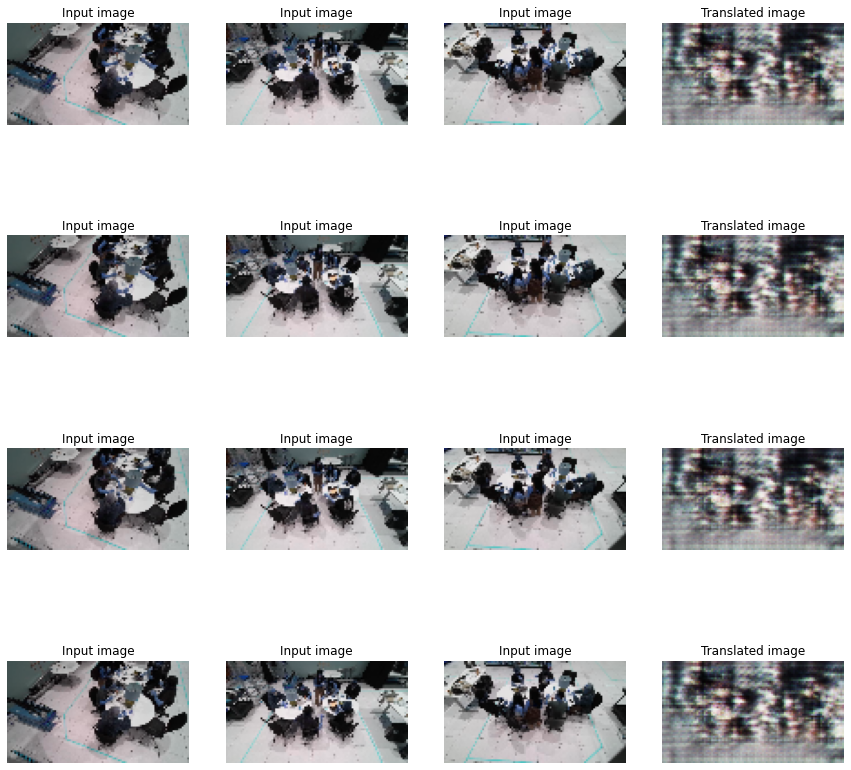

32/32 [==============================] - 22s 703ms/step - X_loss: 6.1769 - Y_loss: 6.7296 - Z_loss: 5.8030 - W_loss: 6.5108 - D_X_loss: 1.0313 - D_Y_loss: 0.9622 - D_Z_loss: 0.9064 - D_W_loss: 0.8567
Epoch 4/50
32/32 [==============================] - ETA: 0s - X_loss: 5.9146 - Y_loss: 6.7289 - Z_loss: 5.9662 - W_loss: 6.3701 - D_X_loss: 0.9968 - D_Y_loss: 0.9108 - D_Z_loss: 1.0677 - D_W_loss: 0.9835

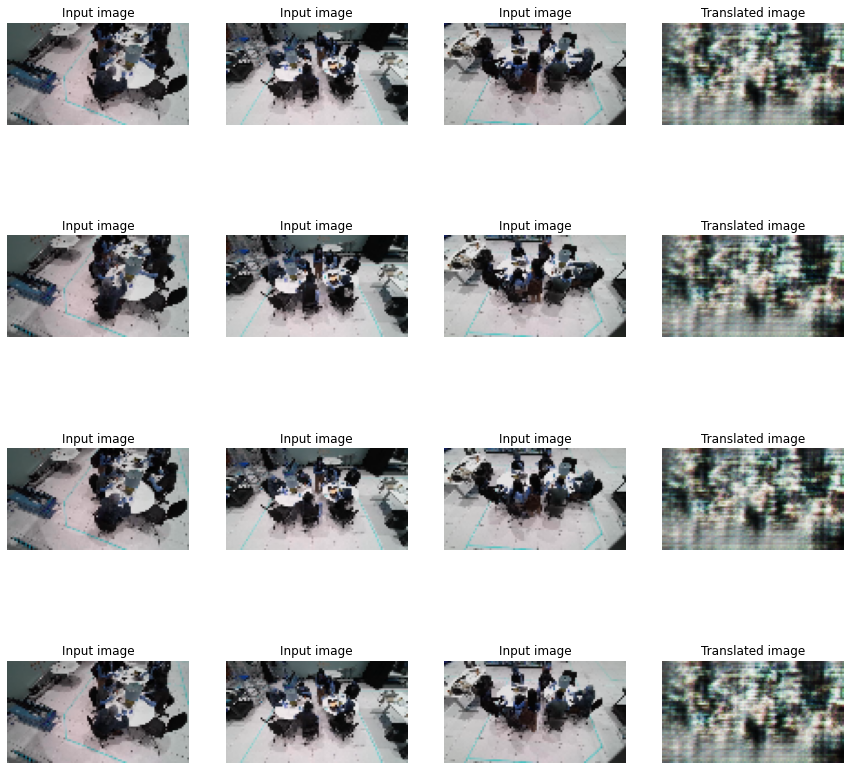

32/32 [==============================] - 22s 702ms/step - X_loss: 5.9725 - Y_loss: 6.7628 - Z_loss: 6.0182 - W_loss: 6.4102 - D_X_loss: 1.0056 - D_Y_loss: 0.9194 - D_Z_loss: 1.0671 - D_W_loss: 0.9921
Epoch 5/50
32/32 [==============================] - ETA: 0s - X_loss: 5.6609 - Y_loss: 6.1993 - Z_loss: 5.4714 - W_loss: 6.2217 - D_X_loss: 0.8936 - D_Y_loss: 0.8558 - D_Z_loss: 0.7079 - D_W_loss: 0.8225

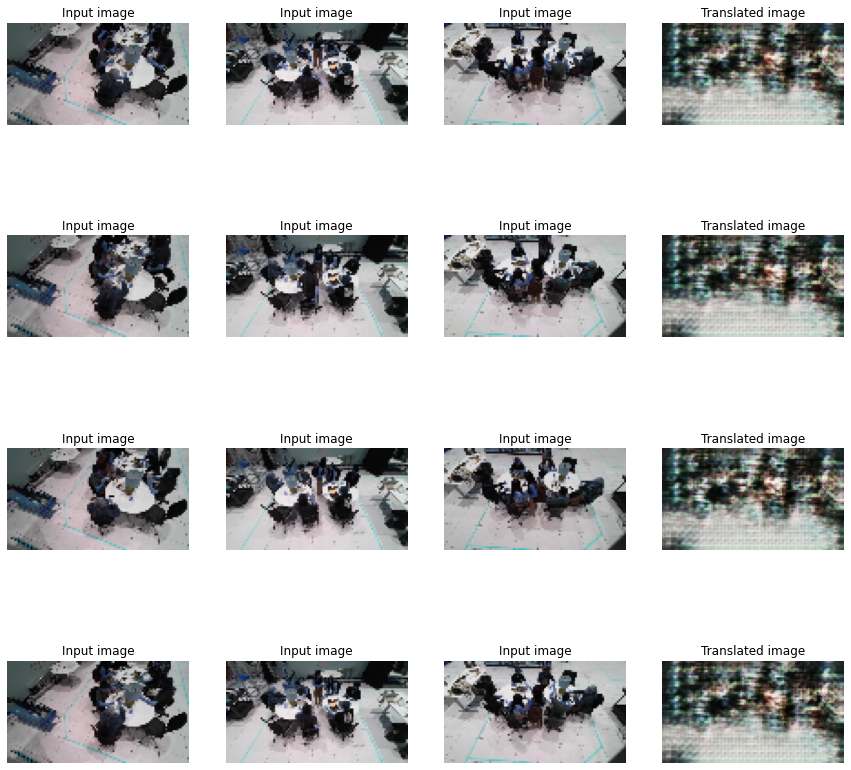

32/32 [==============================] - 22s 702ms/step - X_loss: 5.7129 - Y_loss: 6.2130 - Z_loss: 5.4705 - W_loss: 6.2281 - D_X_loss: 0.9101 - D_Y_loss: 0.8371 - D_Z_loss: 0.7003 - D_W_loss: 0.8167
Epoch 6/50
32/32 [==============================] - ETA: 0s - X_loss: 5.8140 - Y_loss: 6.2733 - Z_loss: 5.6339 - W_loss: 5.8701 - D_X_loss: 0.7728 - D_Y_loss: 0.7688 - D_Z_loss: 0.8266 - D_W_loss: 0.7343

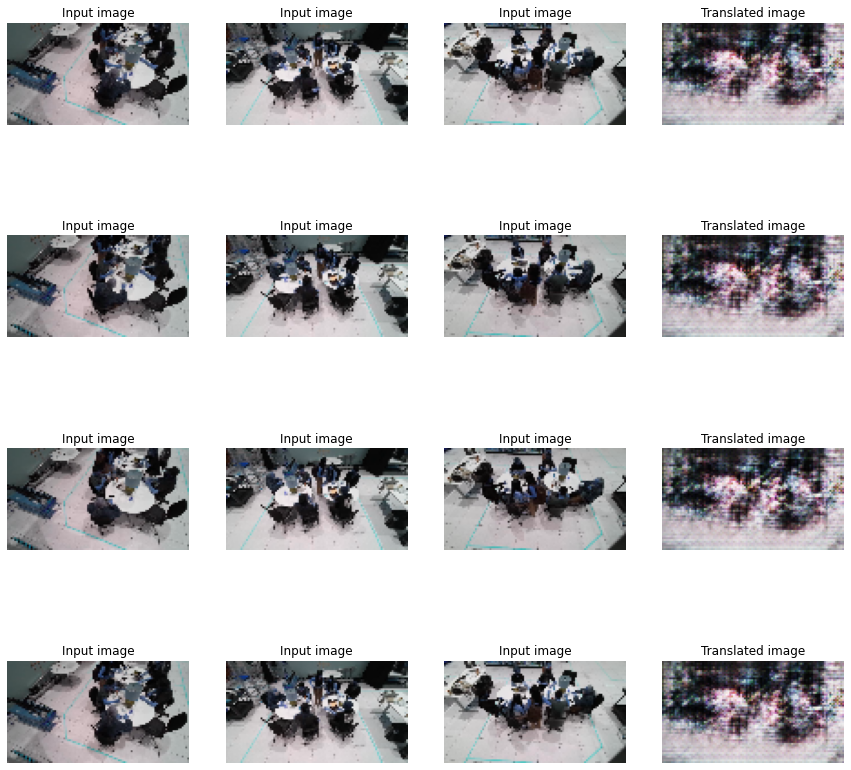

32/32 [==============================] - 22s 699ms/step - X_loss: 5.7918 - Y_loss: 6.2750 - Z_loss: 5.6129 - W_loss: 5.8615 - D_X_loss: 0.7607 - D_Y_loss: 0.7572 - D_Z_loss: 0.8142 - D_W_loss: 0.7454
Epoch 7/50
32/32 [==============================] - ETA: 0s - X_loss: 5.2591 - Y_loss: 6.6349 - Z_loss: 5.4285 - W_loss: 6.0743 - D_X_loss: 1.0888 - D_Y_loss: 0.5952 - D_Z_loss: 0.7395 - D_W_loss: 0.8424

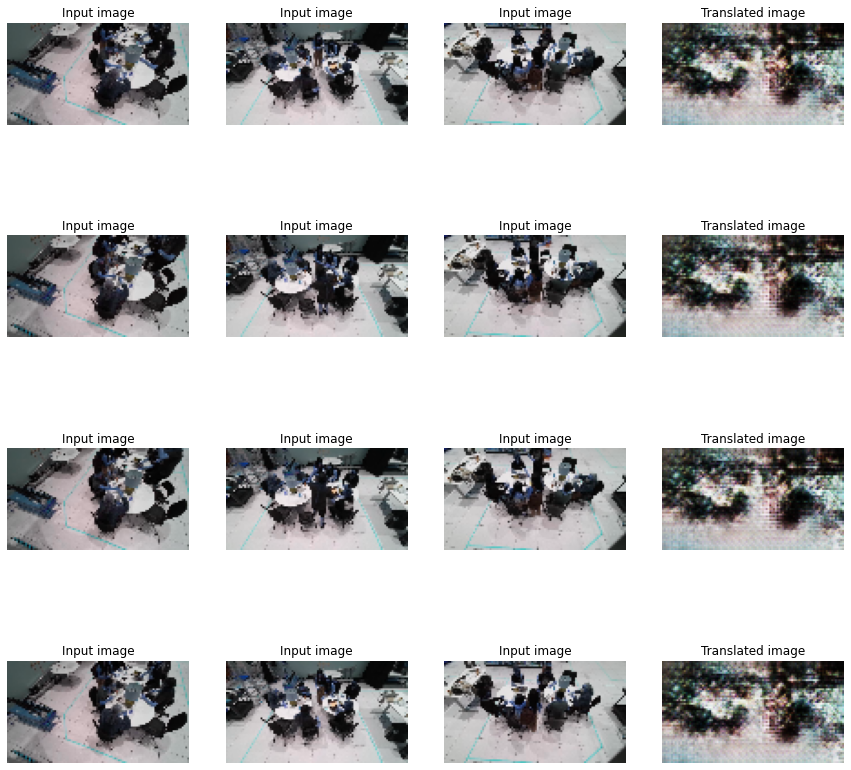

32/32 [==============================] - 23s 709ms/step - X_loss: 5.2121 - Y_loss: 6.5962 - Z_loss: 5.3791 - W_loss: 6.0143 - D_X_loss: 1.0889 - D_Y_loss: 0.6104 - D_Z_loss: 0.7470 - D_W_loss: 0.8374
Epoch 8/50
32/32 [==============================] - ETA: 0s - X_loss: 4.2683 - Y_loss: 6.0292 - Z_loss: 4.8117 - W_loss: 5.0691 - D_X_loss: 1.3273 - D_Y_loss: 0.3355 - D_Z_loss: 0.4274 - D_W_loss: 0.5096

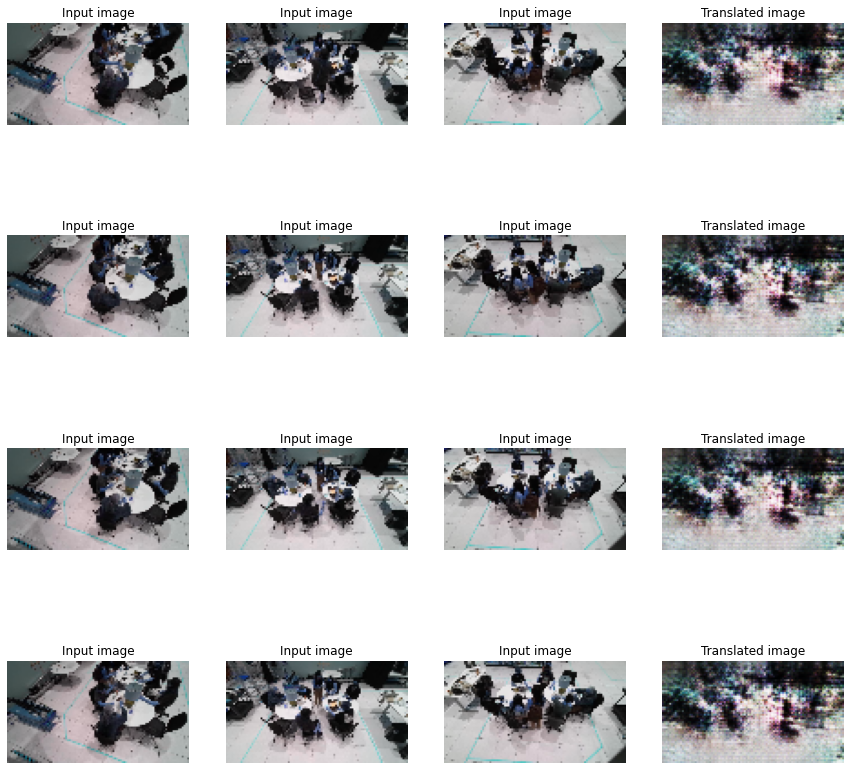

32/32 [==============================] - 22s 701ms/step - X_loss: 4.2570 - Y_loss: 5.9884 - Z_loss: 4.7921 - W_loss: 5.0259 - D_X_loss: 1.3208 - D_Y_loss: 0.3425 - D_Z_loss: 0.4285 - D_W_loss: 0.5153
Epoch 9/50
32/32 [==============================] - ETA: 0s - X_loss: 3.7520 - Y_loss: 4.0094 - Z_loss: 3.5867 - W_loss: 3.7687 - D_X_loss: 1.1467 - D_Y_loss: 0.9416 - D_Z_loss: 0.9551 - D_W_loss: 1.1733

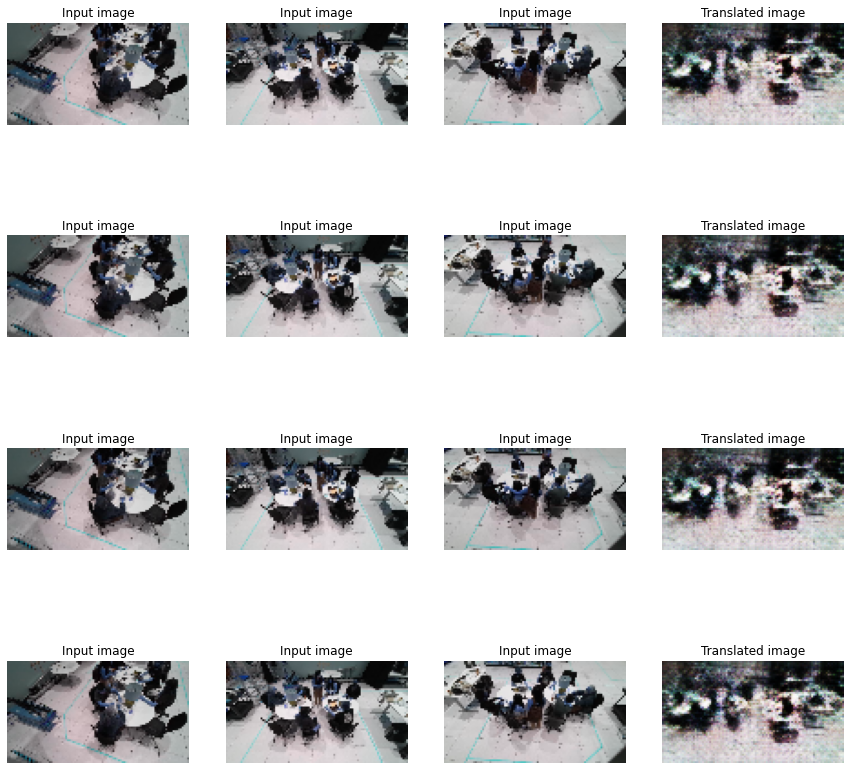

32/32 [==============================] - 22s 705ms/step - X_loss: 3.7291 - Y_loss: 3.9778 - Z_loss: 3.5690 - W_loss: 3.7514 - D_X_loss: 1.1513 - D_Y_loss: 0.9539 - D_Z_loss: 0.9600 - D_W_loss: 1.1680
Epoch 10/50
32/32 [==============================] - ETA: 0s - X_loss: 2.7129 - Y_loss: 2.7925 - Z_loss: 2.4702 - W_loss: 3.0498 - D_X_loss: 1.3783 - D_Y_loss: 1.3141 - D_Z_loss: 1.1883 - D_W_loss: 1.2321

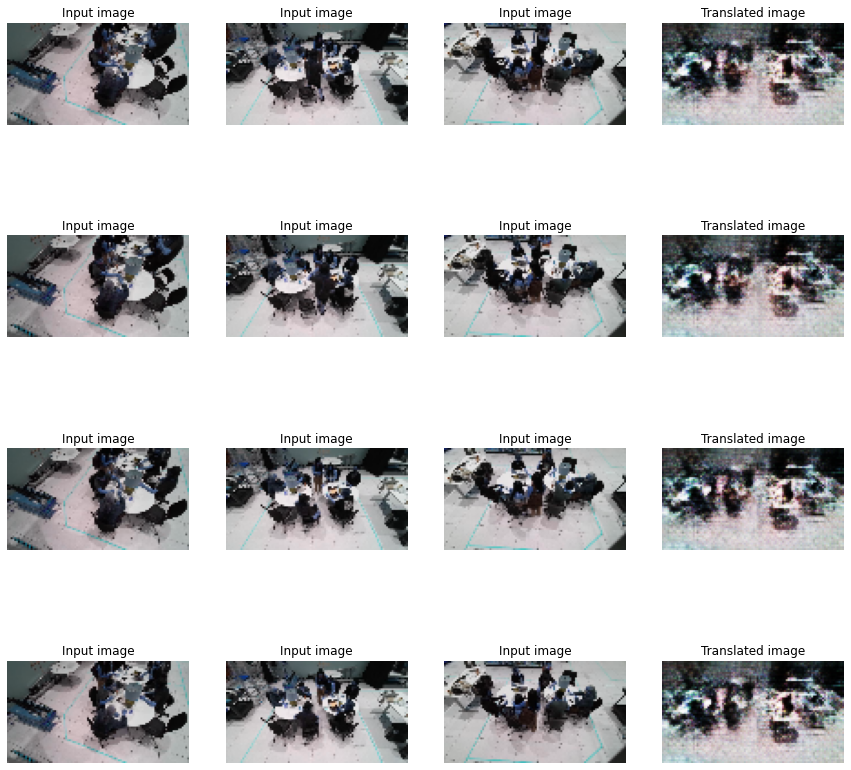

32/32 [==============================] - 22s 703ms/step - X_loss: 2.7161 - Y_loss: 2.7915 - Z_loss: 2.4756 - W_loss: 3.0436 - D_X_loss: 1.3826 - D_Y_loss: 1.3227 - D_Z_loss: 1.1952 - D_W_loss: 1.2367
Epoch 11/50
32/32 [==============================] - ETA: 0s - X_loss: 2.5817 - Y_loss: 2.5922 - Z_loss: 2.2205 - W_loss: 2.8386 - D_X_loss: 1.4011 - D_Y_loss: 1.3470 - D_Z_loss: 1.3293 - D_W_loss: 1.2428

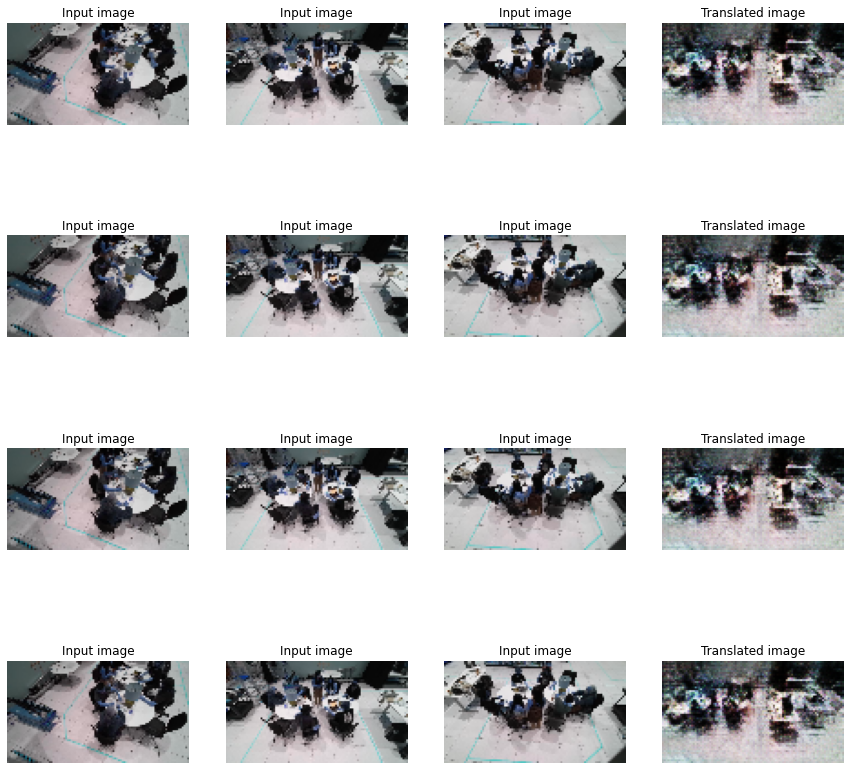

32/32 [==============================] - 22s 702ms/step - X_loss: 2.5720 - Y_loss: 2.5831 - Z_loss: 2.2091 - W_loss: 2.8255 - D_X_loss: 1.4048 - D_Y_loss: 1.3501 - D_Z_loss: 1.3356 - D_W_loss: 1.2473
Epoch 12/50
32/32 [==============================] - ETA: 0s - X_loss: 2.5182 - Y_loss: 2.5449 - Z_loss: 2.1037 - W_loss: 2.7487 - D_X_loss: 1.3692 - D_Y_loss: 1.3056 - D_Z_loss: 1.3861 - D_W_loss: 1.2890

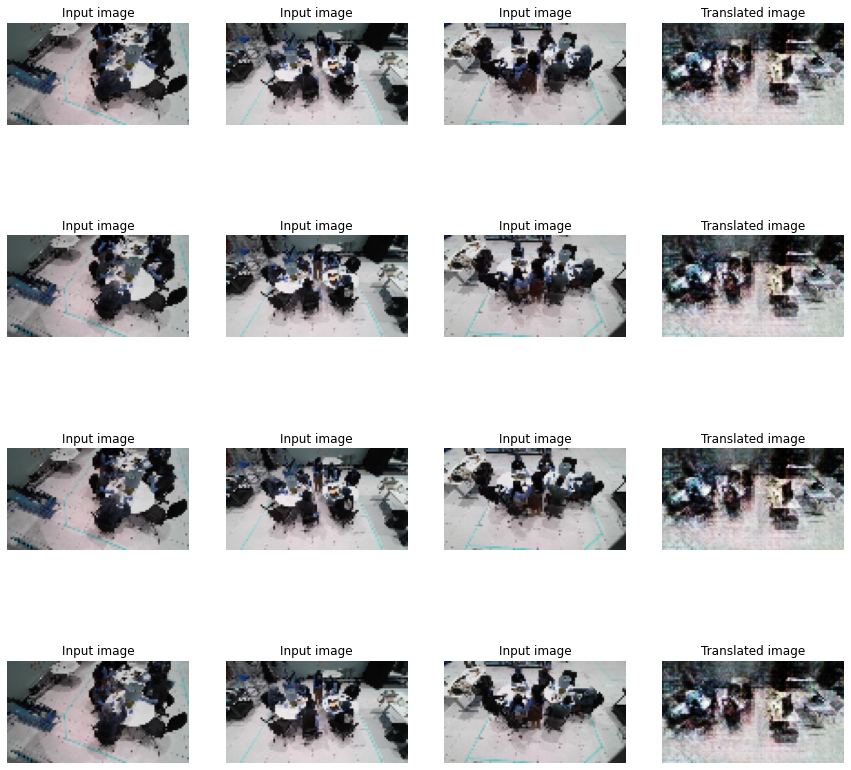

32/32 [==============================] - 22s 701ms/step - X_loss: 2.5250 - Y_loss: 2.5424 - Z_loss: 2.1082 - W_loss: 2.7427 - D_X_loss: 1.3797 - D_Y_loss: 1.3081 - D_Z_loss: 1.3862 - D_W_loss: 1.2962
Epoch 13/50
32/32 [==============================] - ETA: 0s - X_loss: 2.4406 - Y_loss: 2.4963 - Z_loss: 2.0441 - W_loss: 2.7150 - D_X_loss: 1.3973 - D_Y_loss: 1.3018 - D_Z_loss: 1.4082 - D_W_loss: 1.2682

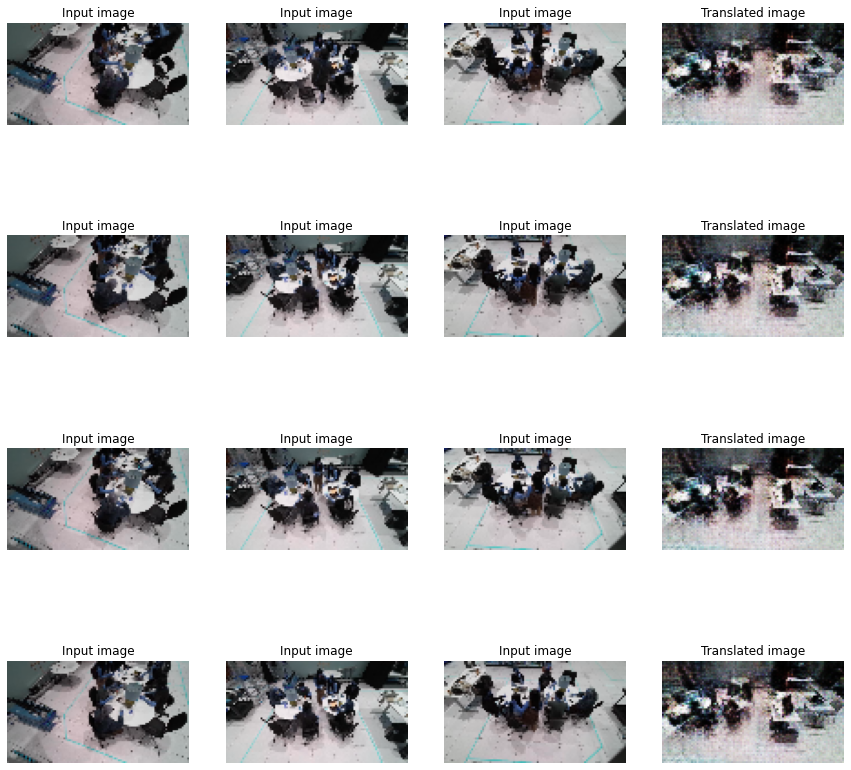

32/32 [==============================] - 22s 701ms/step - X_loss: 2.4368 - Y_loss: 2.4841 - Z_loss: 2.0384 - W_loss: 2.7001 - D_X_loss: 1.3955 - D_Y_loss: 1.3078 - D_Z_loss: 1.4130 - D_W_loss: 1.2696
Epoch 14/50
32/32 [==============================] - ETA: 0s - X_loss: 2.4046 - Y_loss: 2.3983 - Z_loss: 1.9537 - W_loss: 2.5760 - D_X_loss: 1.3147 - D_Y_loss: 1.3471 - D_Z_loss: 1.4586 - D_W_loss: 1.2558

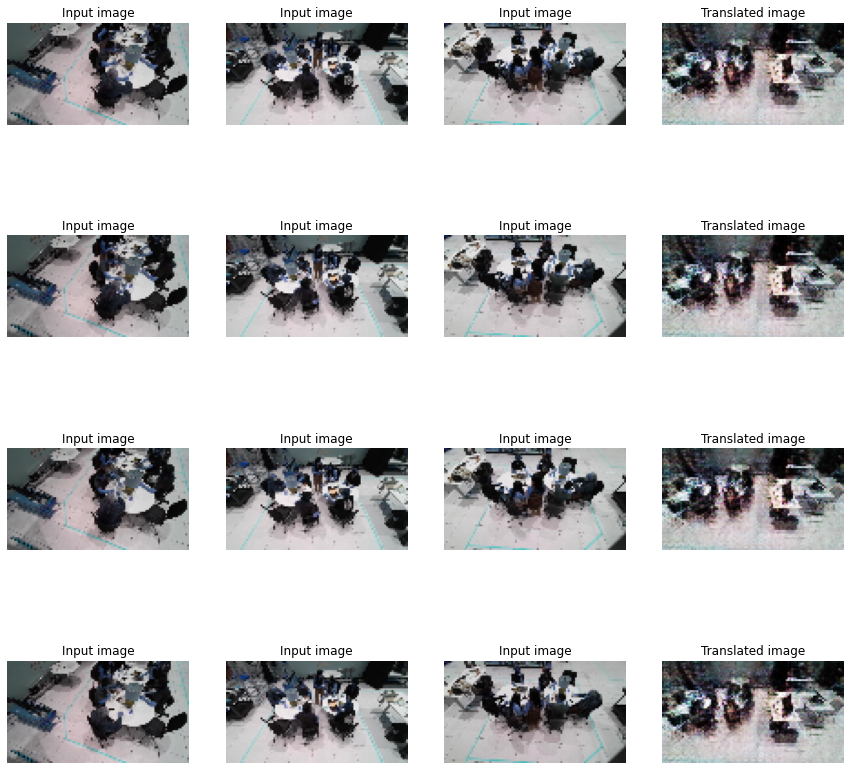

32/32 [==============================] - 22s 703ms/step - X_loss: 2.3977 - Y_loss: 2.3908 - Z_loss: 1.9563 - W_loss: 2.5634 - D_X_loss: 1.3105 - D_Y_loss: 1.3527 - D_Z_loss: 1.4569 - D_W_loss: 1.2652
Epoch 15/50
32/32 [==============================] - ETA: 0s - X_loss: 2.3102 - Y_loss: 2.4209 - Z_loss: 1.9484 - W_loss: 2.6153 - D_X_loss: 1.5208 - D_Y_loss: 1.2811 - D_Z_loss: 1.4138 - D_W_loss: 1.2254

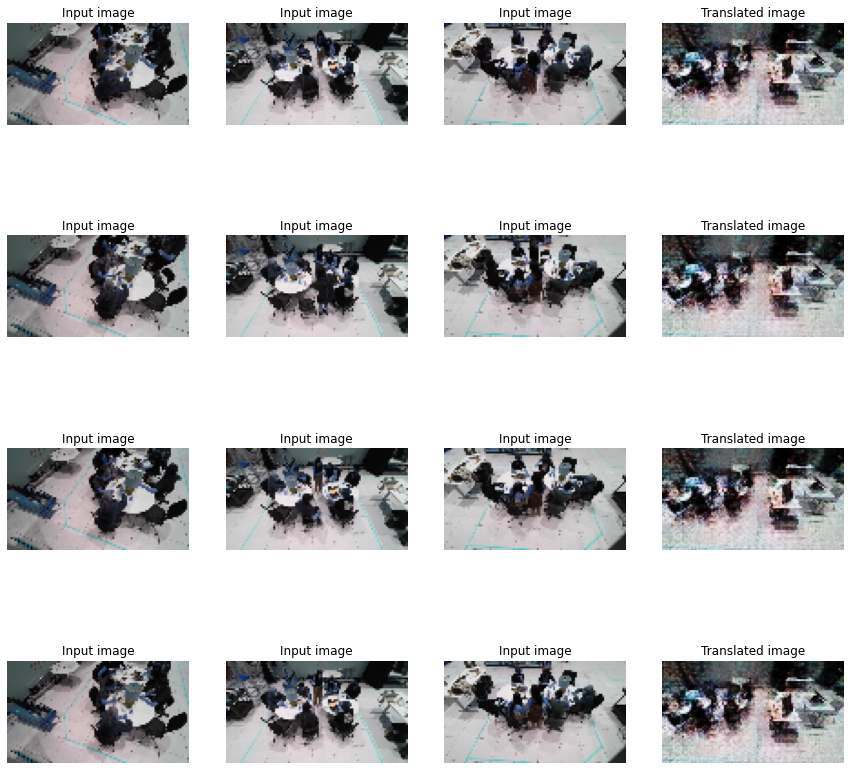

32/32 [==============================] - 24s 744ms/step - X_loss: 2.3024 - Y_loss: 2.4105 - Z_loss: 1.9401 - W_loss: 2.5986 - D_X_loss: 1.5222 - D_Y_loss: 1.2859 - D_Z_loss: 1.4148 - D_W_loss: 1.2347
Epoch 16/50
32/32 [==============================] - ETA: 0s - X_loss: 2.3280 - Y_loss: 2.3656 - Z_loss: 1.9114 - W_loss: 2.6072 - D_X_loss: 1.4041 - D_Y_loss: 1.3009 - D_Z_loss: 1.4534 - D_W_loss: 1.2208

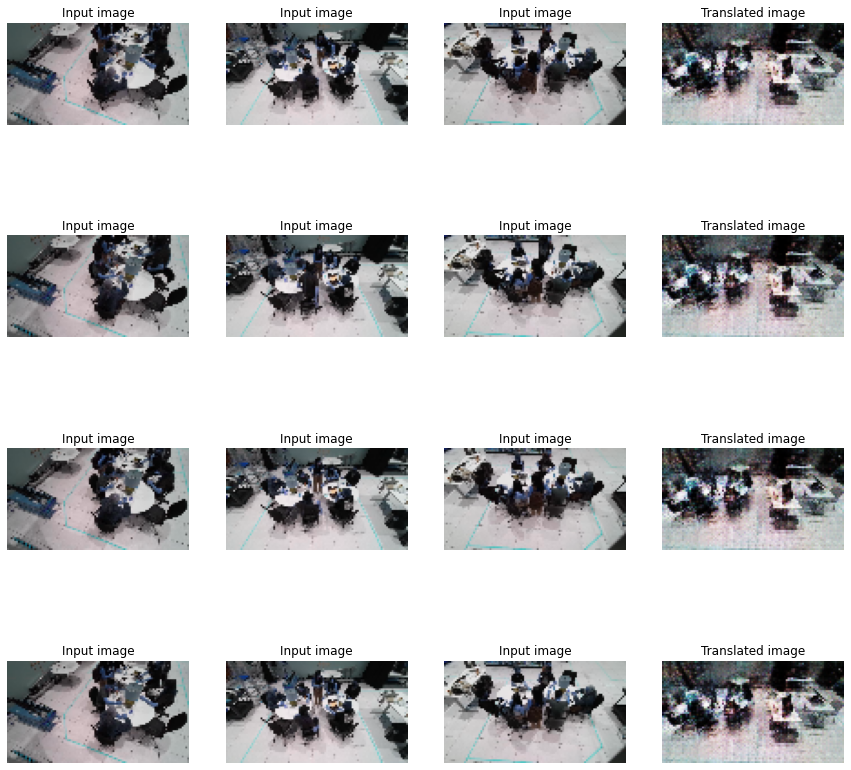

32/32 [==============================] - 22s 703ms/step - X_loss: 2.3215 - Y_loss: 2.3583 - Z_loss: 1.9044 - W_loss: 2.5925 - D_X_loss: 1.4031 - D_Y_loss: 1.3051 - D_Z_loss: 1.4554 - D_W_loss: 1.2228
Epoch 17/50
32/32 [==============================] - ETA: 0s - X_loss: 2.1707 - Y_loss: 2.2040 - Z_loss: 1.7976 - W_loss: 2.3414 - D_X_loss: 1.4617 - D_Y_loss: 1.4066 - D_Z_loss: 1.4946 - D_W_loss: 1.3858

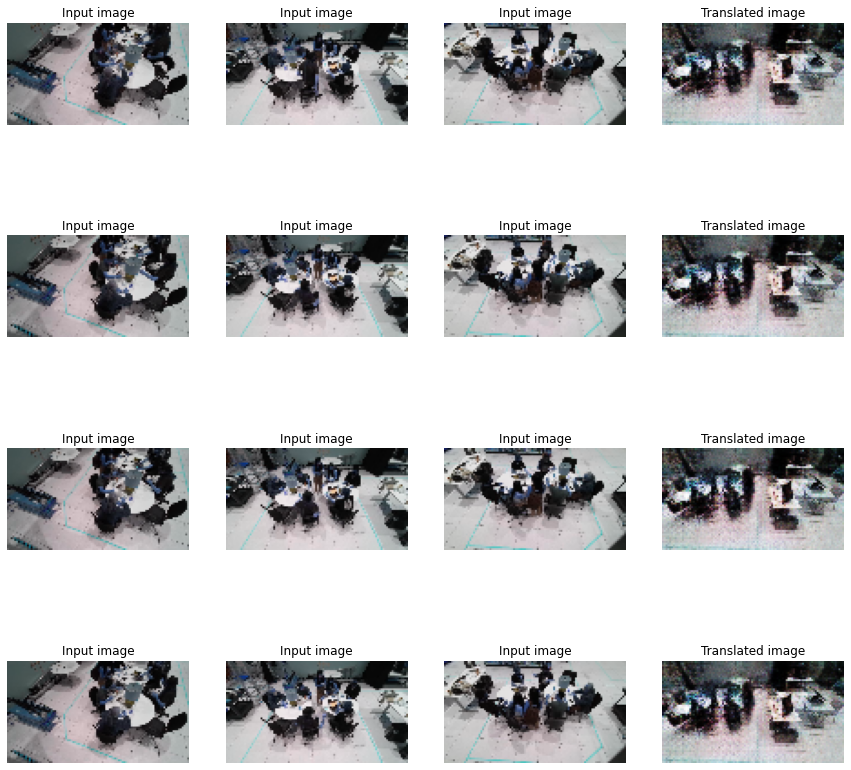

32/32 [==============================] - 22s 702ms/step - X_loss: 2.1667 - Y_loss: 2.1993 - Z_loss: 1.7967 - W_loss: 2.3355 - D_X_loss: 1.4647 - D_Y_loss: 1.4141 - D_Z_loss: 1.4948 - D_W_loss: 1.3889
Epoch 18/50
32/32 [==============================] - ETA: 0s - X_loss: 2.2490 - Y_loss: 2.2313 - Z_loss: 1.8400 - W_loss: 2.4131 - D_X_loss: 1.2898 - D_Y_loss: 1.2961 - D_Z_loss: 1.4159 - D_W_loss: 1.2284

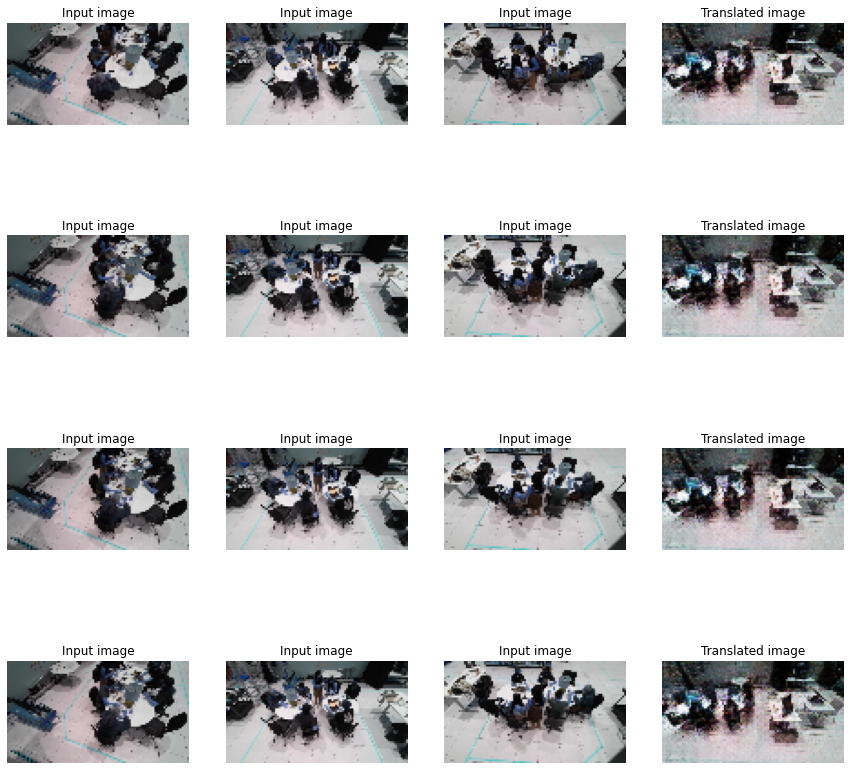

32/32 [==============================] - 22s 703ms/step - X_loss: 2.2452 - Y_loss: 2.2269 - Z_loss: 1.8375 - W_loss: 2.3999 - D_X_loss: 1.2894 - D_Y_loss: 1.2911 - D_Z_loss: 1.4135 - D_W_loss: 1.2329
Epoch 19/50
32/32 [==============================] - ETA: 0s - X_loss: 2.2349 - Y_loss: 2.2215 - Z_loss: 1.7566 - W_loss: 2.4045 - D_X_loss: 1.3508 - D_Y_loss: 1.2731 - D_Z_loss: 1.4614 - D_W_loss: 1.2077

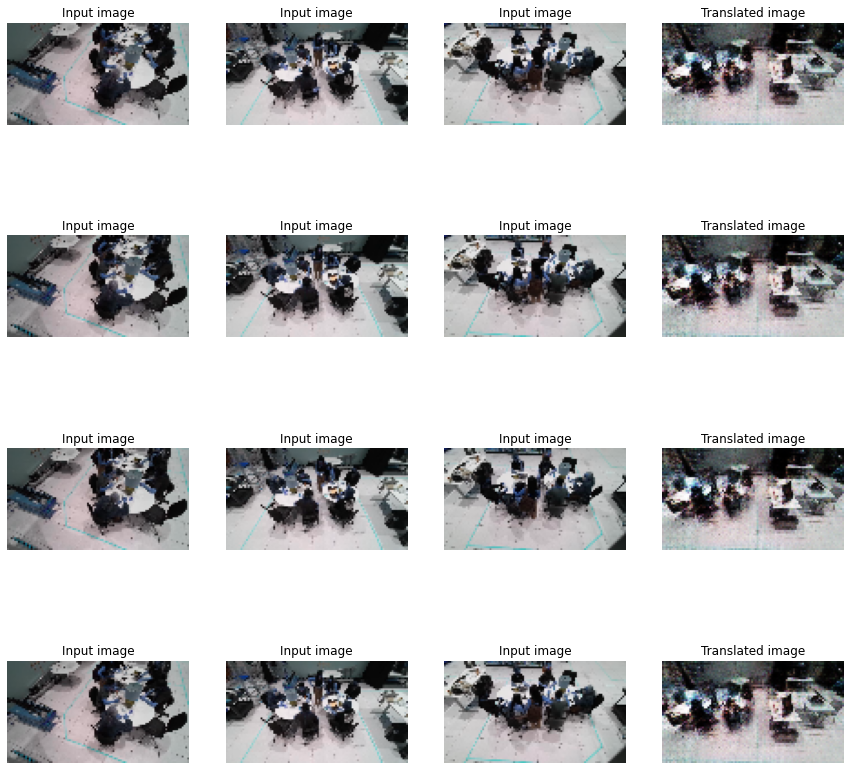

32/32 [==============================] - 22s 704ms/step - X_loss: 2.2376 - Y_loss: 2.2198 - Z_loss: 1.7573 - W_loss: 2.3902 - D_X_loss: 1.3501 - D_Y_loss: 1.2731 - D_Z_loss: 1.4590 - D_W_loss: 1.2194
Epoch 20/50
32/32 [==============================] - ETA: 0s - X_loss: 2.1912 - Y_loss: 2.2092 - Z_loss: 1.7434 - W_loss: 2.3109 - D_X_loss: 1.2159 - D_Y_loss: 1.2317 - D_Z_loss: 1.4618 - D_W_loss: 1.2552

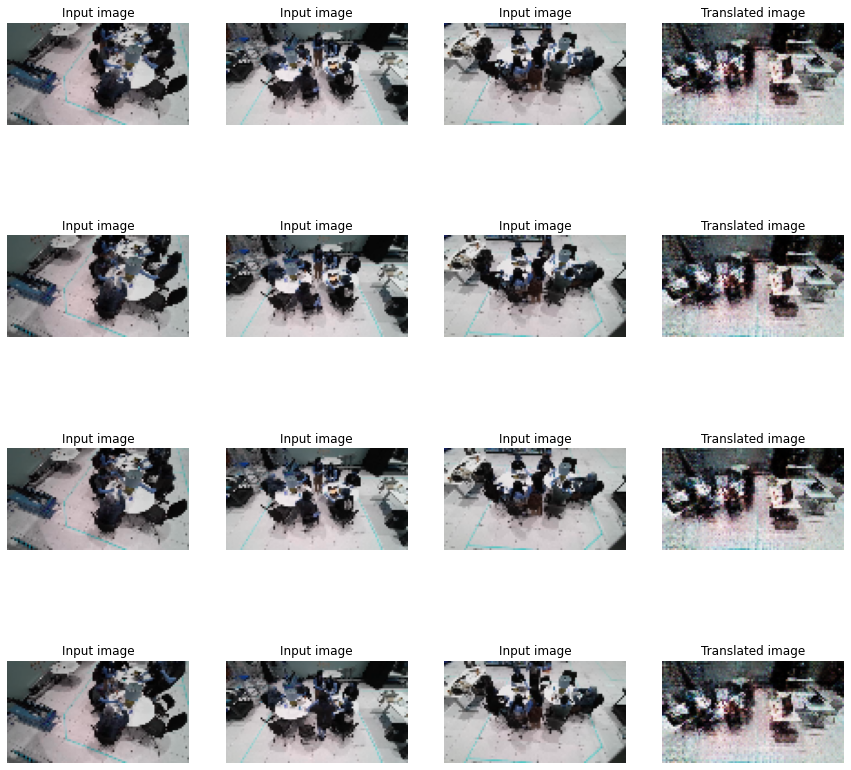

32/32 [==============================] - 22s 704ms/step - X_loss: 2.1794 - Y_loss: 2.2018 - Z_loss: 1.7383 - W_loss: 2.3006 - D_X_loss: 1.2222 - D_Y_loss: 1.2370 - D_Z_loss: 1.4628 - D_W_loss: 1.2665
Epoch 21/50
32/32 [==============================] - ETA: 0s - X_loss: 2.2279 - Y_loss: 2.0693 - Z_loss: 1.7560 - W_loss: 2.3949 - D_X_loss: 1.2763 - D_Y_loss: 1.3580 - D_Z_loss: 1.4219 - D_W_loss: 1.2061

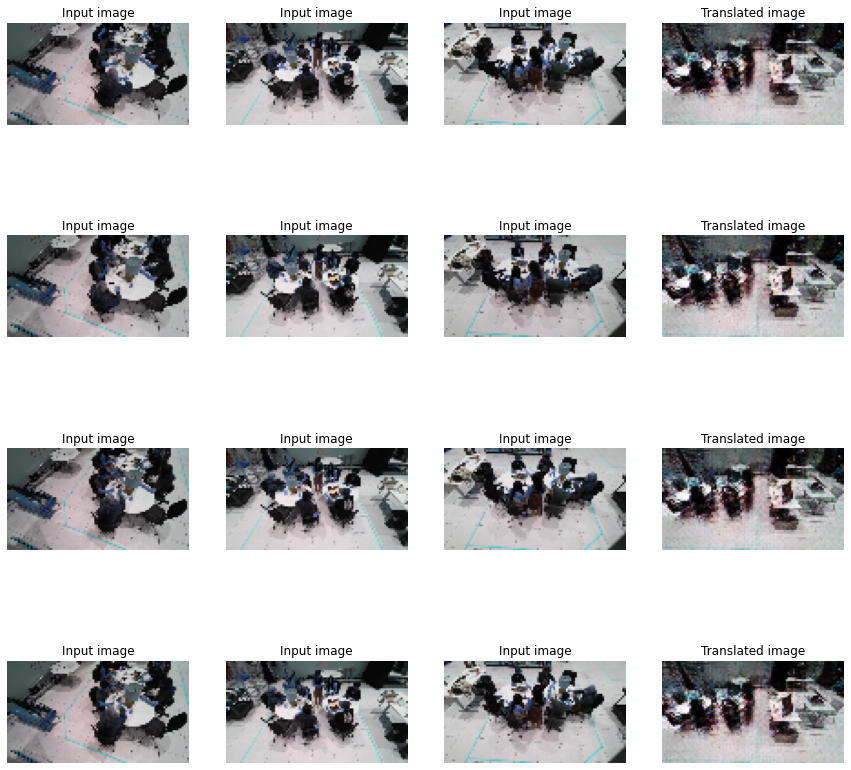

32/32 [==============================] - 22s 701ms/step - X_loss: 2.2312 - Y_loss: 2.0684 - Z_loss: 1.7582 - W_loss: 2.3766 - D_X_loss: 1.2752 - D_Y_loss: 1.3619 - D_Z_loss: 1.4200 - D_W_loss: 1.2186
Epoch 22/50
32/32 [==============================] - ETA: 0s - X_loss: 2.1640 - Y_loss: 2.1286 - Z_loss: 1.7127 - W_loss: 2.2166 - D_X_loss: 1.2214 - D_Y_loss: 1.2384 - D_Z_loss: 1.4048 - D_W_loss: 1.2868

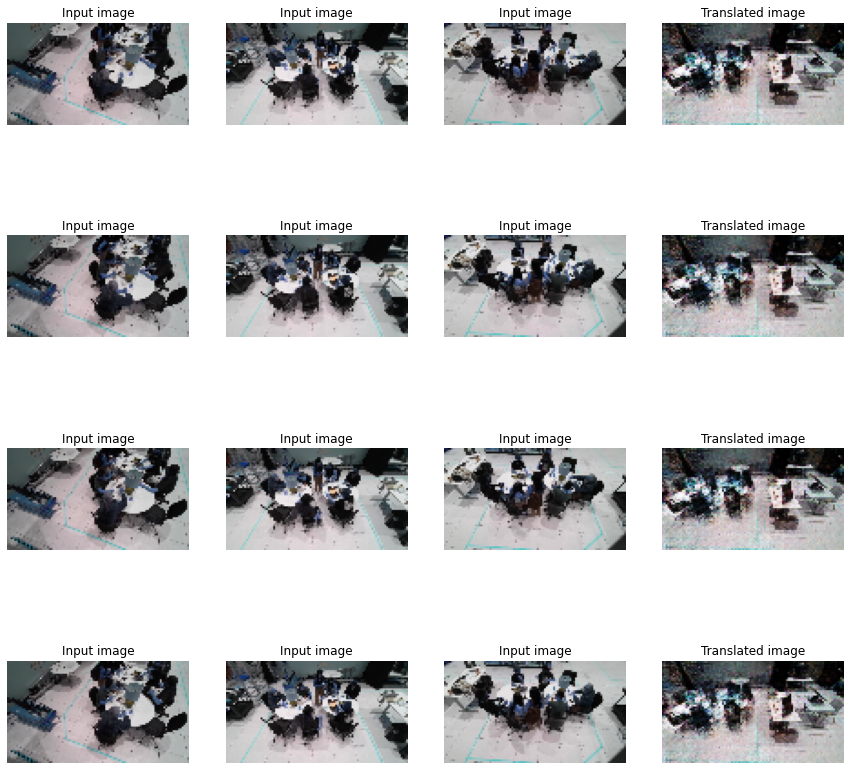

32/32 [==============================] - 22s 701ms/step - X_loss: 2.1719 - Y_loss: 2.1303 - Z_loss: 1.7154 - W_loss: 2.2125 - D_X_loss: 1.2229 - D_Y_loss: 1.2401 - D_Z_loss: 1.4109 - D_W_loss: 1.2944
Epoch 23/50
32/32 [==============================] - ETA: 0s - X_loss: 1.9742 - Y_loss: 2.1042 - Z_loss: 1.6593 - W_loss: 2.2732 - D_X_loss: 1.4655 - D_Y_loss: 1.3377 - D_Z_loss: 1.5033 - D_W_loss: 1.2484

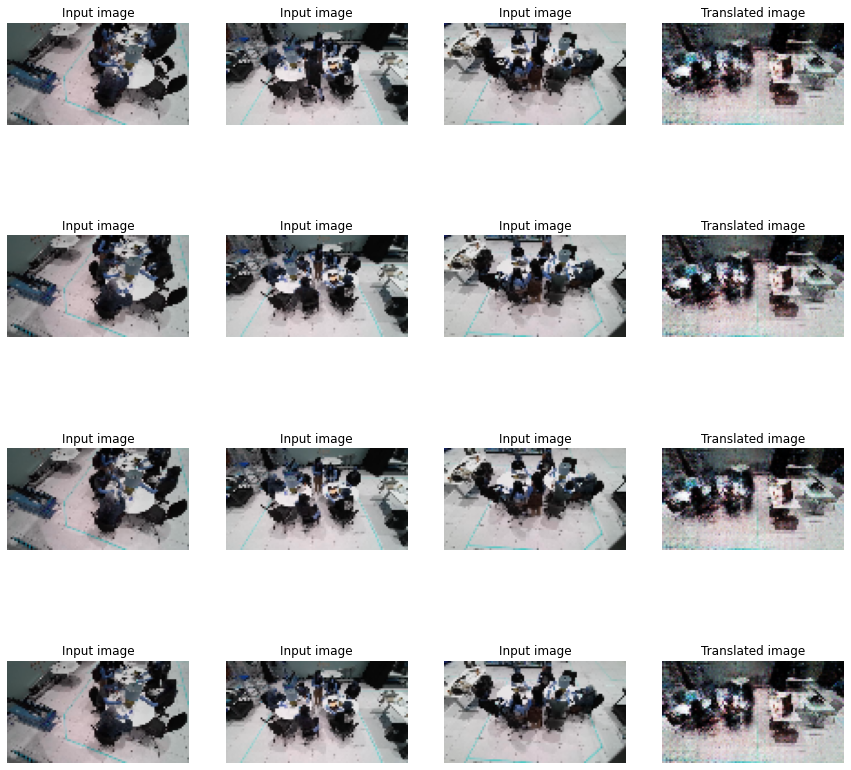

32/32 [==============================] - 22s 700ms/step - X_loss: 1.9715 - Y_loss: 2.0934 - Z_loss: 1.6559 - W_loss: 2.2570 - D_X_loss: 1.4656 - D_Y_loss: 1.3551 - D_Z_loss: 1.5022 - D_W_loss: 1.2606
Epoch 24/50
32/32 [==============================] - ETA: 0s - X_loss: 2.0938 - Y_loss: 2.0374 - Z_loss: 1.6988 - W_loss: 2.4184 - D_X_loss: 1.3306 - D_Y_loss: 1.3665 - D_Z_loss: 1.4512 - D_W_loss: 1.0846

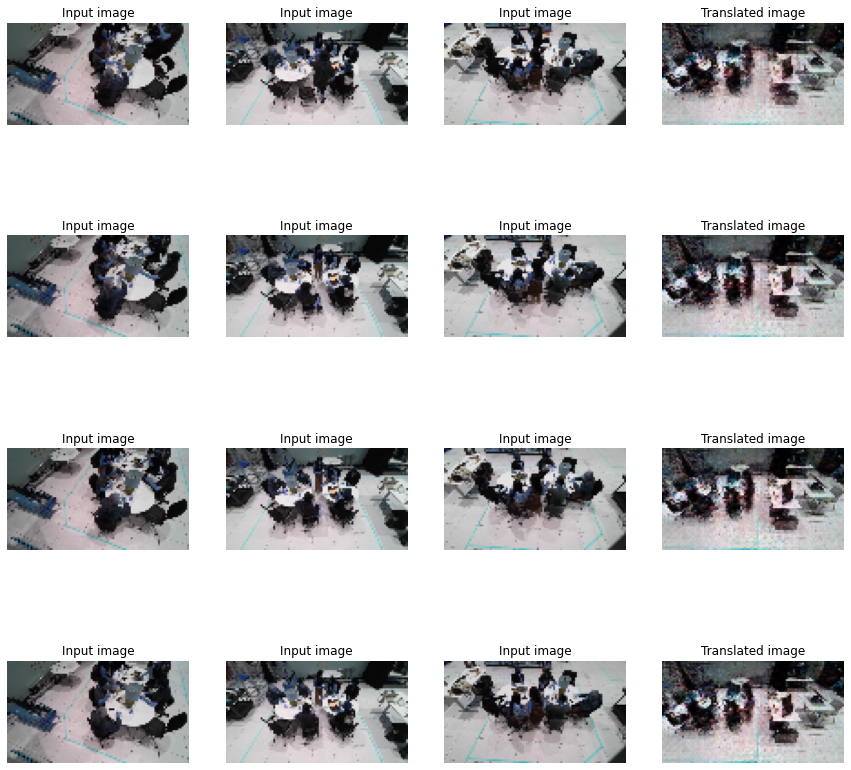

32/32 [==============================] - 22s 701ms/step - X_loss: 2.0895 - Y_loss: 2.0330 - Z_loss: 1.7000 - W_loss: 2.4192 - D_X_loss: 1.3325 - D_Y_loss: 1.3725 - D_Z_loss: 1.4510 - D_W_loss: 1.0765
Epoch 25/50
32/32 [==============================] - ETA: 0s - X_loss: 2.0784 - Y_loss: 2.0113 - Z_loss: 1.6268 - W_loss: 2.1008 - D_X_loss: 1.1922 - D_Y_loss: 1.3092 - D_Z_loss: 1.4282 - D_W_loss: 1.3474

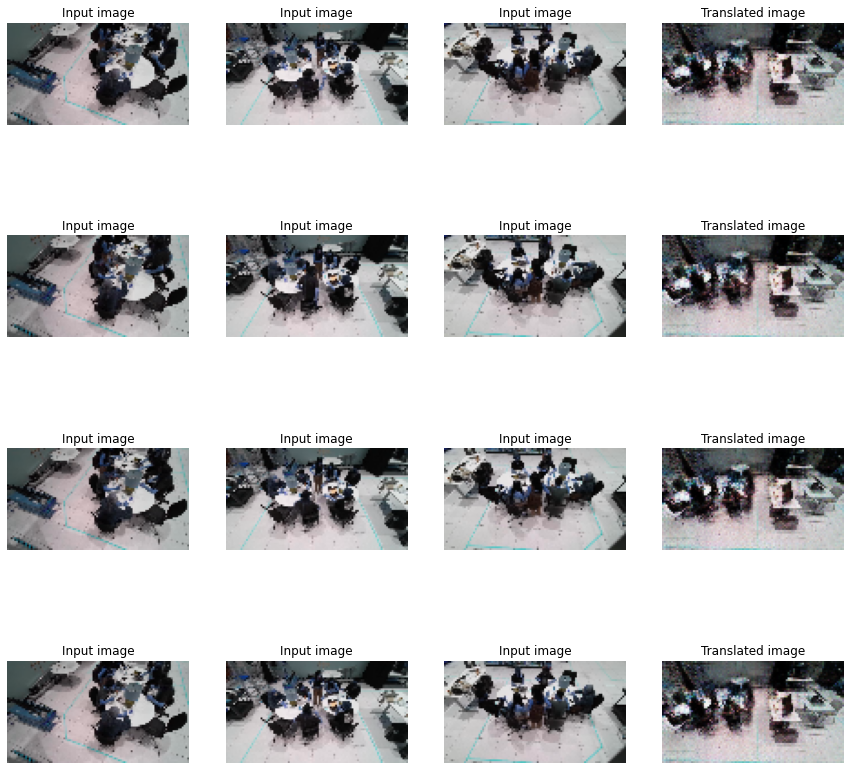

32/32 [==============================] - 22s 703ms/step - X_loss: 2.0783 - Y_loss: 2.0056 - Z_loss: 1.6276 - W_loss: 2.0915 - D_X_loss: 1.1934 - D_Y_loss: 1.3155 - D_Z_loss: 1.4248 - D_W_loss: 1.3522
Epoch 26/50
32/32 [==============================] - ETA: 0s - X_loss: 2.0655 - Y_loss: 2.1353 - Z_loss: 1.6396 - W_loss: 2.2100 - D_X_loss: 1.2232 - D_Y_loss: 1.1856 - D_Z_loss: 1.4095 - D_W_loss: 1.2158

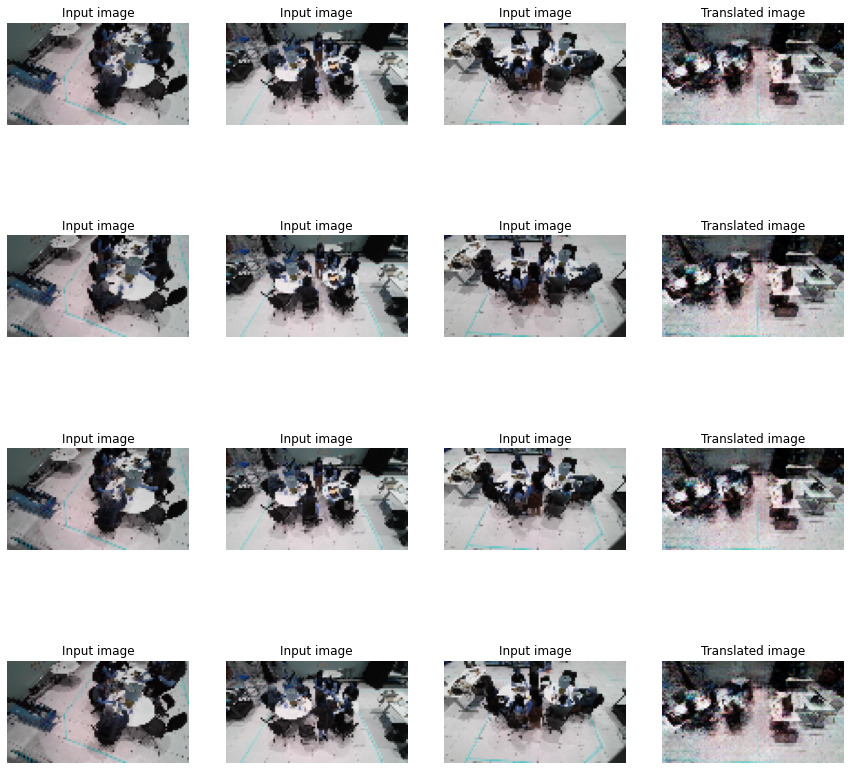

32/32 [==============================] - 22s 703ms/step - X_loss: 2.0617 - Y_loss: 2.1326 - Z_loss: 1.6365 - W_loss: 2.1987 - D_X_loss: 1.2267 - D_Y_loss: 1.1837 - D_Z_loss: 1.4116 - D_W_loss: 1.2230
Epoch 27/50
32/32 [==============================] - ETA: 0s - X_loss: 1.9935 - Y_loss: 2.0408 - Z_loss: 1.6694 - W_loss: 2.2414 - D_X_loss: 1.3989 - D_Y_loss: 1.3285 - D_Z_loss: 1.4340 - D_W_loss: 1.2120

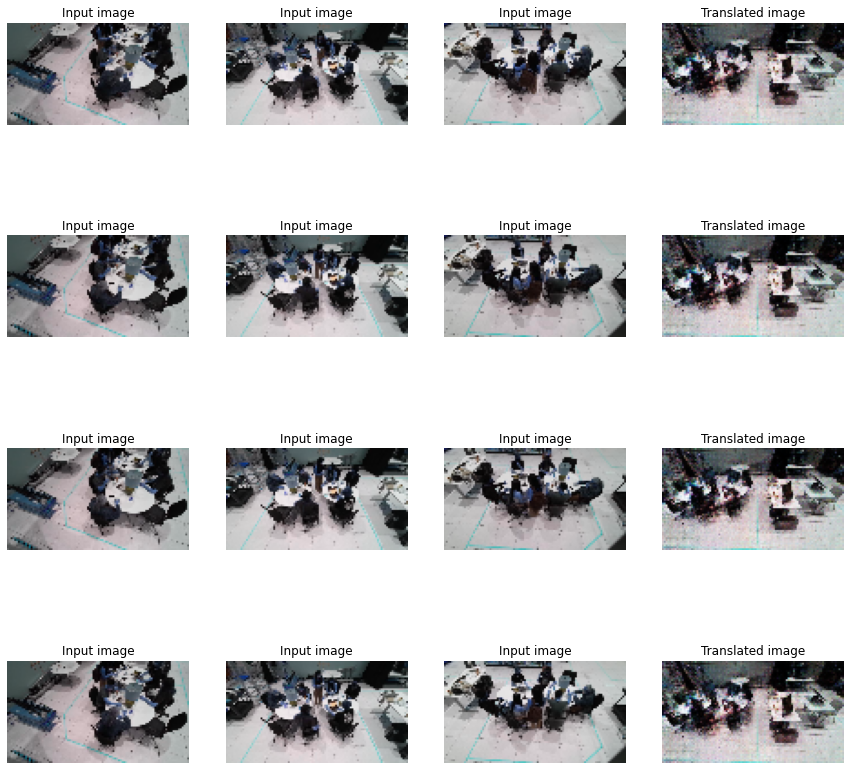

32/32 [==============================] - 22s 701ms/step - X_loss: 1.9854 - Y_loss: 2.0259 - Z_loss: 1.6631 - W_loss: 2.2247 - D_X_loss: 1.4032 - D_Y_loss: 1.3444 - D_Z_loss: 1.4315 - D_W_loss: 1.2251
Epoch 28/50
32/32 [==============================] - ETA: 0s - X_loss: 2.1041 - Y_loss: 1.9757 - Z_loss: 1.5873 - W_loss: 2.2447 - D_X_loss: 1.2018 - D_Y_loss: 1.3159 - D_Z_loss: 1.4262 - D_W_loss: 1.1491

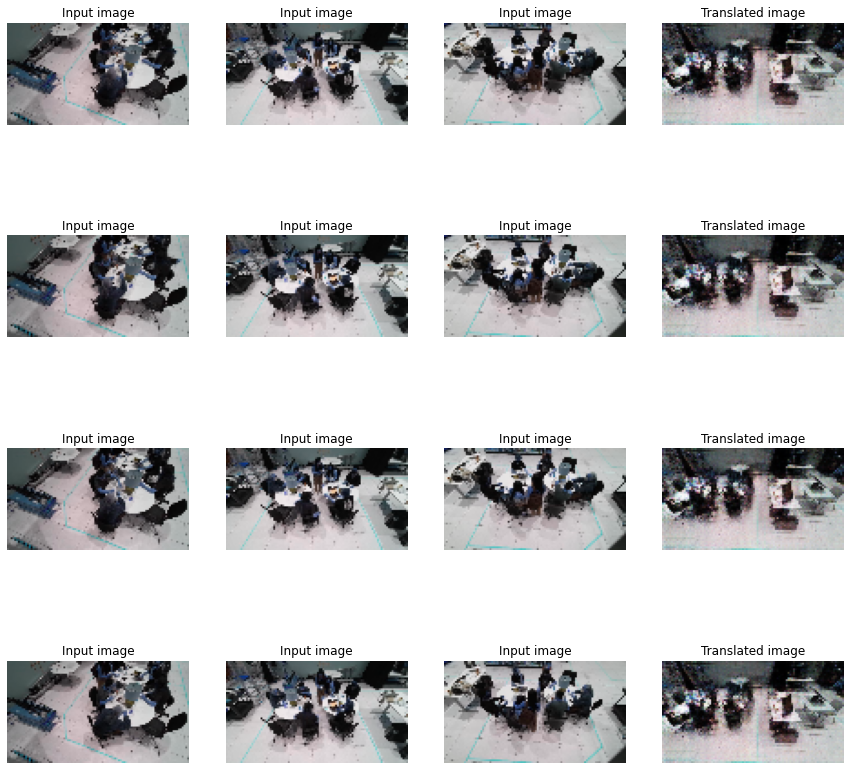

32/32 [==============================] - 22s 702ms/step - X_loss: 2.1032 - Y_loss: 1.9743 - Z_loss: 1.5912 - W_loss: 2.2364 - D_X_loss: 1.1982 - D_Y_loss: 1.3197 - D_Z_loss: 1.4207 - D_W_loss: 1.1667
Epoch 29/50
32/32 [==============================] - ETA: 0s - X_loss: 2.0497 - Y_loss: 2.0269 - Z_loss: 1.6322 - W_loss: 2.2345 - D_X_loss: 1.2174 - D_Y_loss: 1.2538 - D_Z_loss: 1.4032 - D_W_loss: 1.1583

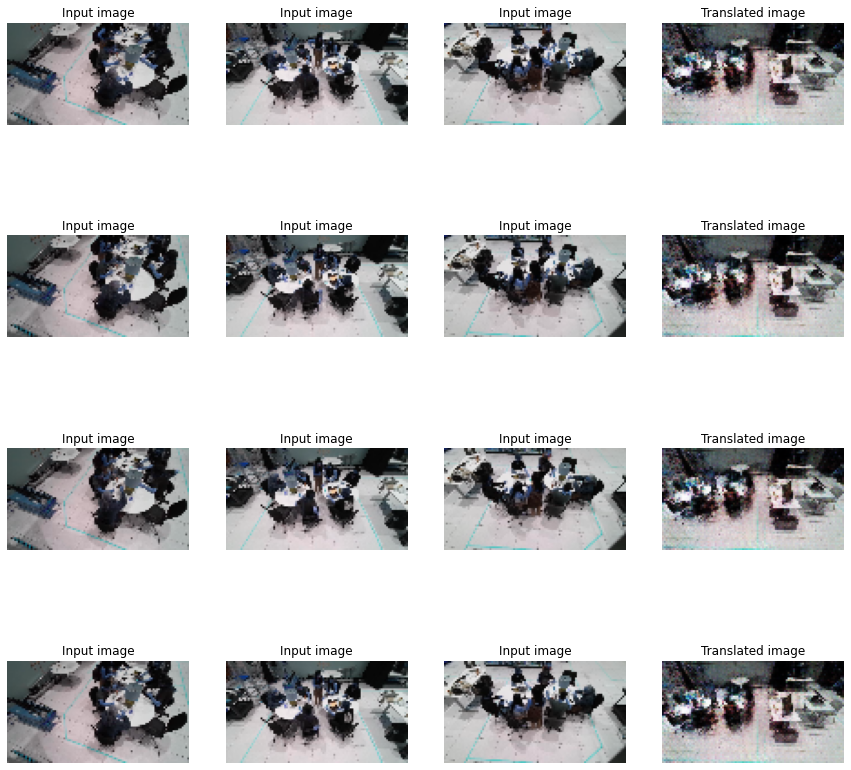

32/32 [==============================] - 22s 702ms/step - X_loss: 2.0457 - Y_loss: 2.0170 - Z_loss: 1.6282 - W_loss: 2.2183 - D_X_loss: 1.2199 - D_Y_loss: 1.2634 - D_Z_loss: 1.4009 - D_W_loss: 1.1690
Epoch 30/50
32/32 [==============================] - ETA: 0s - X_loss: 2.0736 - Y_loss: 1.9034 - Z_loss: 1.6054 - W_loss: 2.1851 - D_X_loss: 1.1654 - D_Y_loss: 1.3157 - D_Z_loss: 1.3935 - D_W_loss: 1.1589

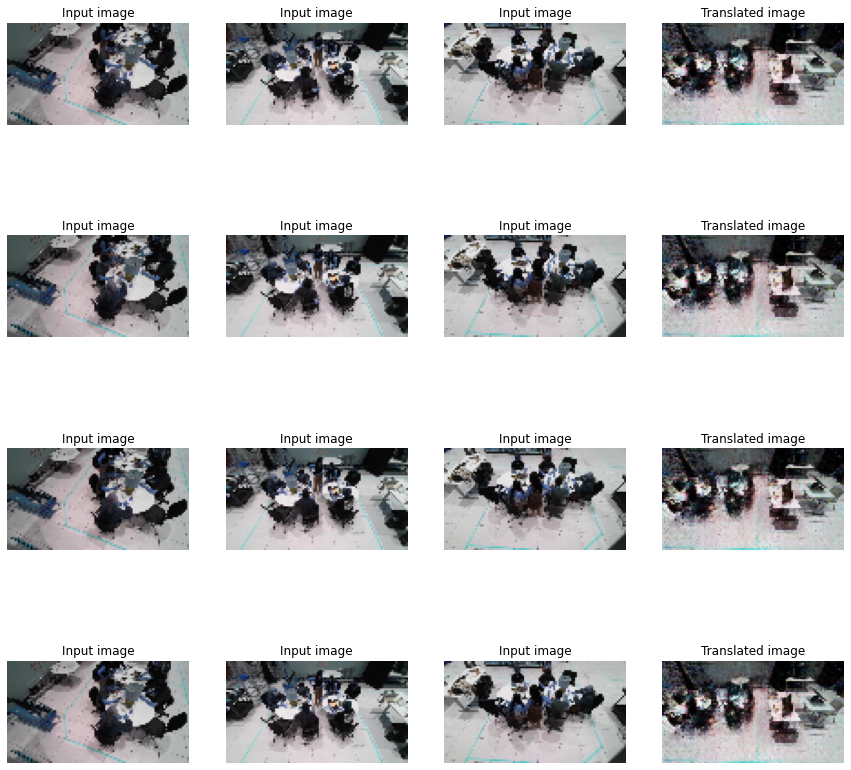

32/32 [==============================] - 24s 744ms/step - X_loss: 2.0741 - Y_loss: 1.9061 - Z_loss: 1.6106 - W_loss: 2.1786 - D_X_loss: 1.1674 - D_Y_loss: 1.3158 - D_Z_loss: 1.3936 - D_W_loss: 1.1759
Epoch 31/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8647 - Y_loss: 1.9204 - Z_loss: 1.5649 - W_loss: 2.0067 - D_X_loss: 1.3512 - D_Y_loss: 1.3314 - D_Z_loss: 1.4100 - D_W_loss: 1.3645

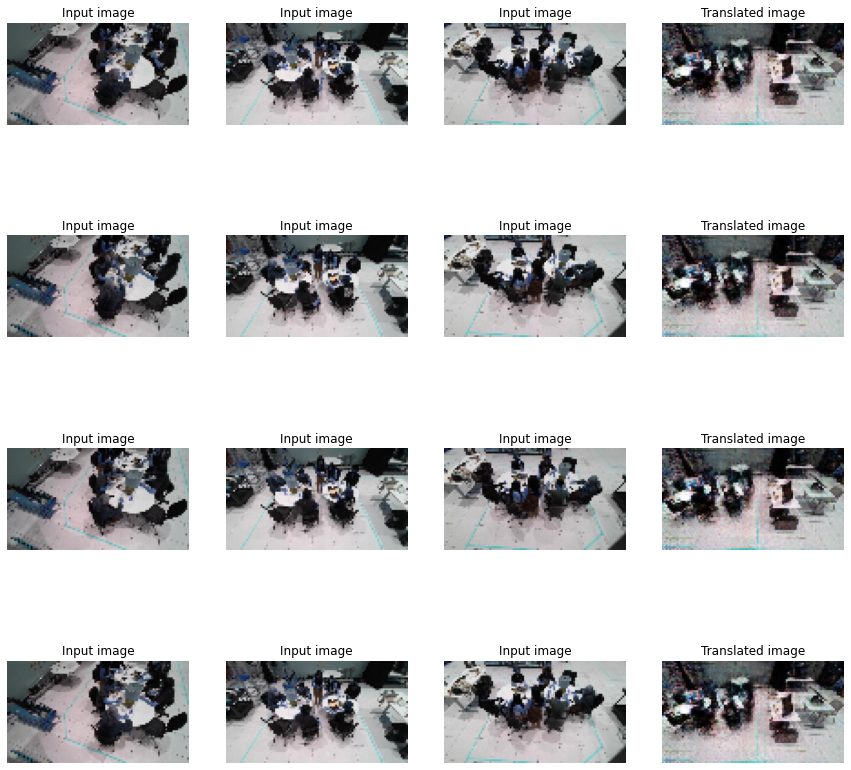

32/32 [==============================] - 22s 703ms/step - X_loss: 1.8678 - Y_loss: 1.9142 - Z_loss: 1.5633 - W_loss: 2.0027 - D_X_loss: 1.3473 - D_Y_loss: 1.3382 - D_Z_loss: 1.4100 - D_W_loss: 1.3657
Epoch 32/50
32/32 [==============================] - ETA: 0s - X_loss: 1.9634 - Y_loss: 1.9412 - Z_loss: 1.5964 - W_loss: 2.1263 - D_X_loss: 1.2981 - D_Y_loss: 1.2789 - D_Z_loss: 1.4160 - D_W_loss: 1.2369

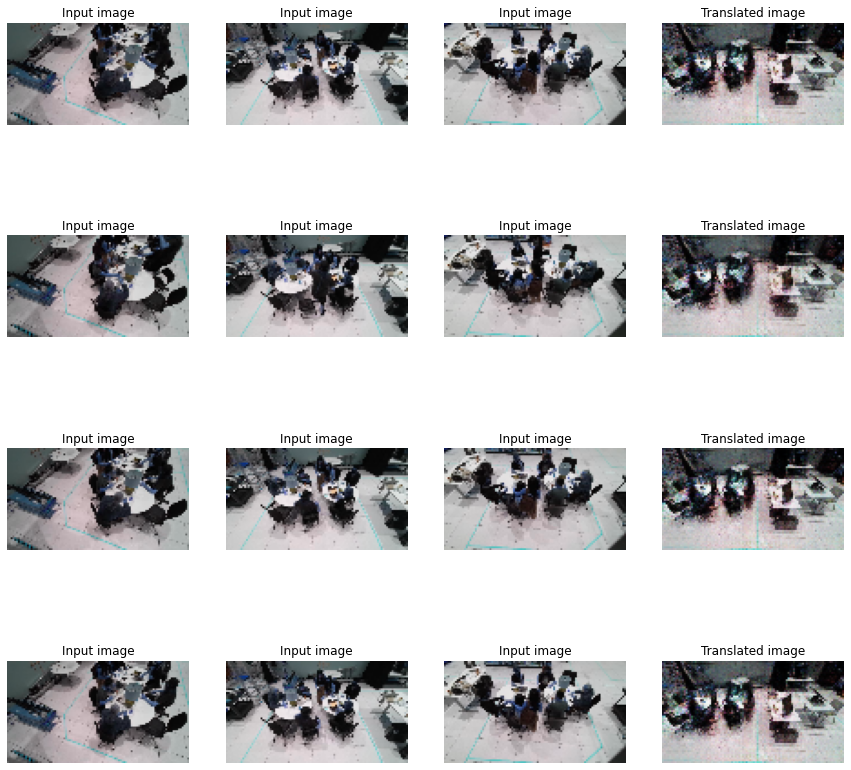

32/32 [==============================] - 22s 702ms/step - X_loss: 1.9625 - Y_loss: 1.9390 - Z_loss: 1.5952 - W_loss: 2.1129 - D_X_loss: 1.2965 - D_Y_loss: 1.2780 - D_Z_loss: 1.4165 - D_W_loss: 1.2502
Epoch 33/50
32/32 [==============================] - ETA: 0s - X_loss: 1.9673 - Y_loss: 1.8787 - Z_loss: 1.5432 - W_loss: 2.0491 - D_X_loss: 1.2048 - D_Y_loss: 1.3170 - D_Z_loss: 1.3898 - D_W_loss: 1.2528

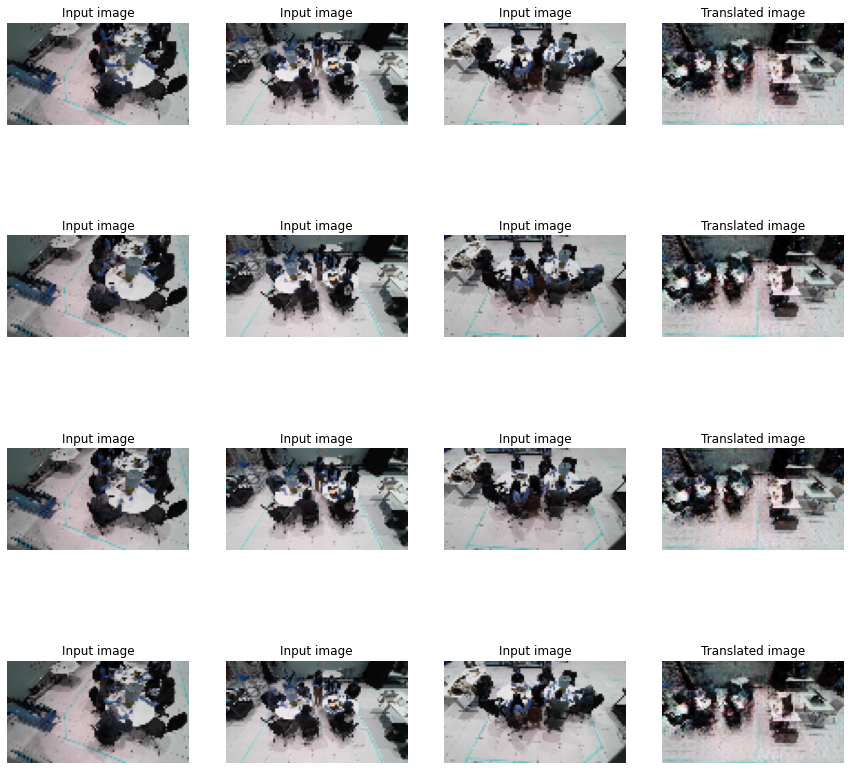

32/32 [==============================] - 22s 703ms/step - X_loss: 1.9702 - Y_loss: 1.8789 - Z_loss: 1.5451 - W_loss: 2.0476 - D_X_loss: 1.2123 - D_Y_loss: 1.3257 - D_Z_loss: 1.3915 - D_W_loss: 1.2613
Epoch 34/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8898 - Y_loss: 1.8804 - Z_loss: 1.5372 - W_loss: 2.0630 - D_X_loss: 1.2710 - D_Y_loss: 1.3043 - D_Z_loss: 1.3915 - D_W_loss: 1.2352

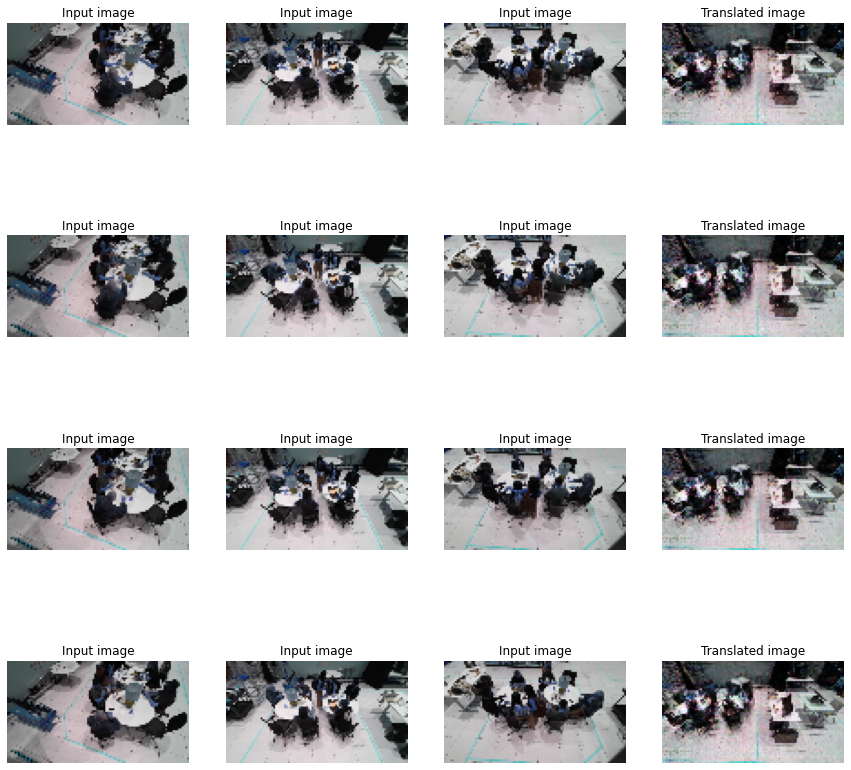

32/32 [==============================] - 22s 702ms/step - X_loss: 1.8924 - Y_loss: 1.8802 - Z_loss: 1.5380 - W_loss: 2.0566 - D_X_loss: 1.2670 - D_Y_loss: 1.3049 - D_Z_loss: 1.3882 - D_W_loss: 1.2378
Epoch 35/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8910 - Y_loss: 1.8326 - Z_loss: 1.5396 - W_loss: 1.9726 - D_X_loss: 1.2781 - D_Y_loss: 1.3355 - D_Z_loss: 1.4229 - D_W_loss: 1.3162

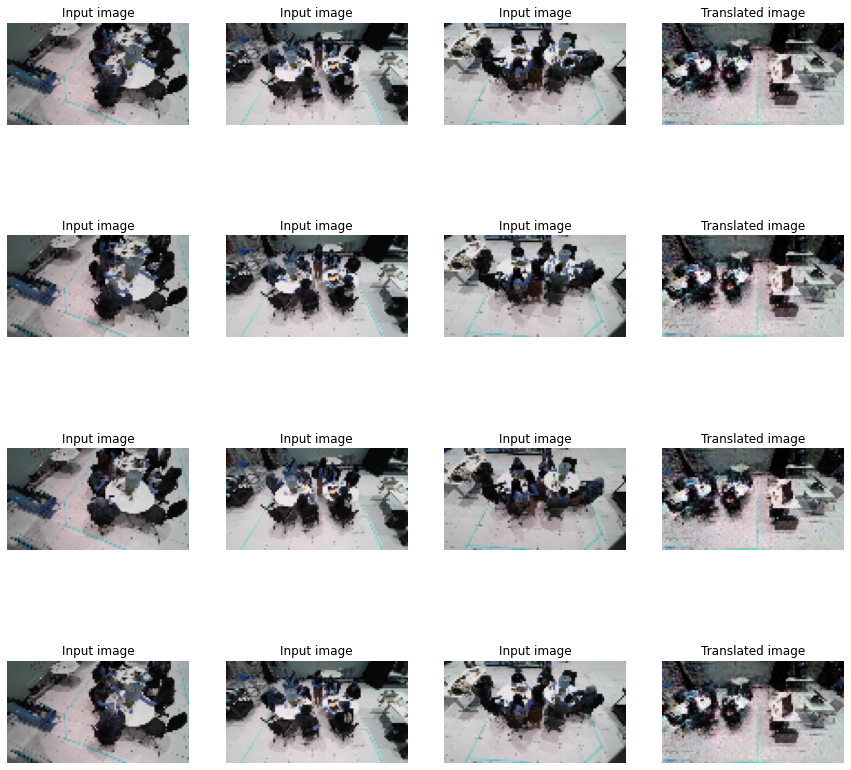

32/32 [==============================] - 22s 702ms/step - X_loss: 1.8906 - Y_loss: 1.8318 - Z_loss: 1.5374 - W_loss: 1.9698 - D_X_loss: 1.2748 - D_Y_loss: 1.3356 - D_Z_loss: 1.4253 - D_W_loss: 1.3160
Epoch 36/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8859 - Y_loss: 1.8294 - Z_loss: 1.5262 - W_loss: 2.0298 - D_X_loss: 1.2599 - D_Y_loss: 1.3212 - D_Z_loss: 1.3935 - D_W_loss: 1.2147

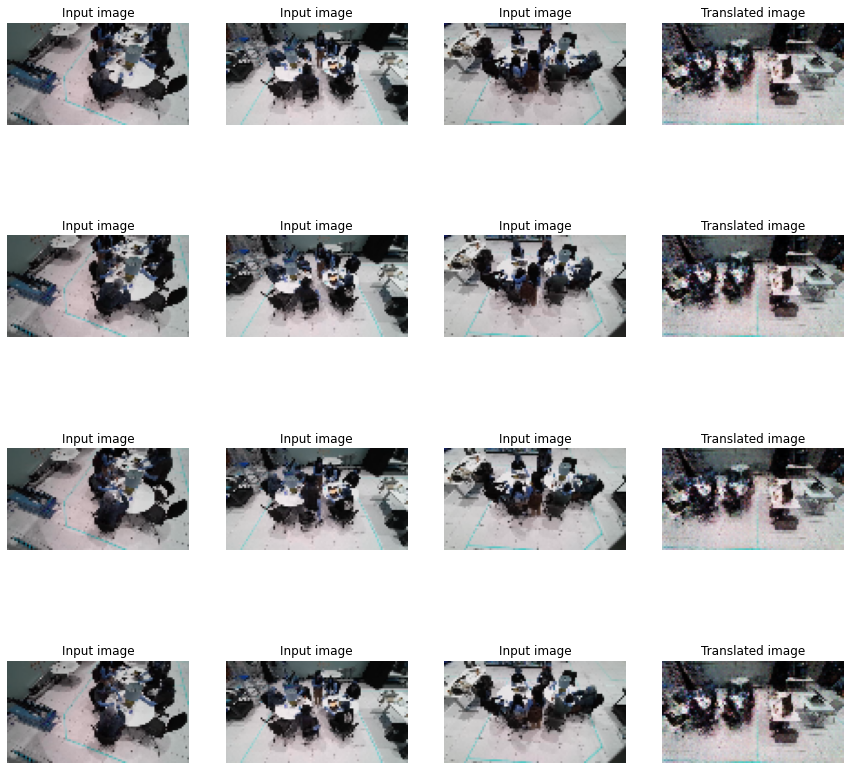

32/32 [==============================] - 22s 702ms/step - X_loss: 1.8861 - Y_loss: 1.8334 - Z_loss: 1.5280 - W_loss: 2.0229 - D_X_loss: 1.2584 - D_Y_loss: 1.3242 - D_Z_loss: 1.3934 - D_W_loss: 1.2224
Epoch 37/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8242 - Y_loss: 1.8063 - Z_loss: 1.4877 - W_loss: 1.9253 - D_X_loss: 1.3075 - D_Y_loss: 1.3159 - D_Z_loss: 1.3796 - D_W_loss: 1.2656

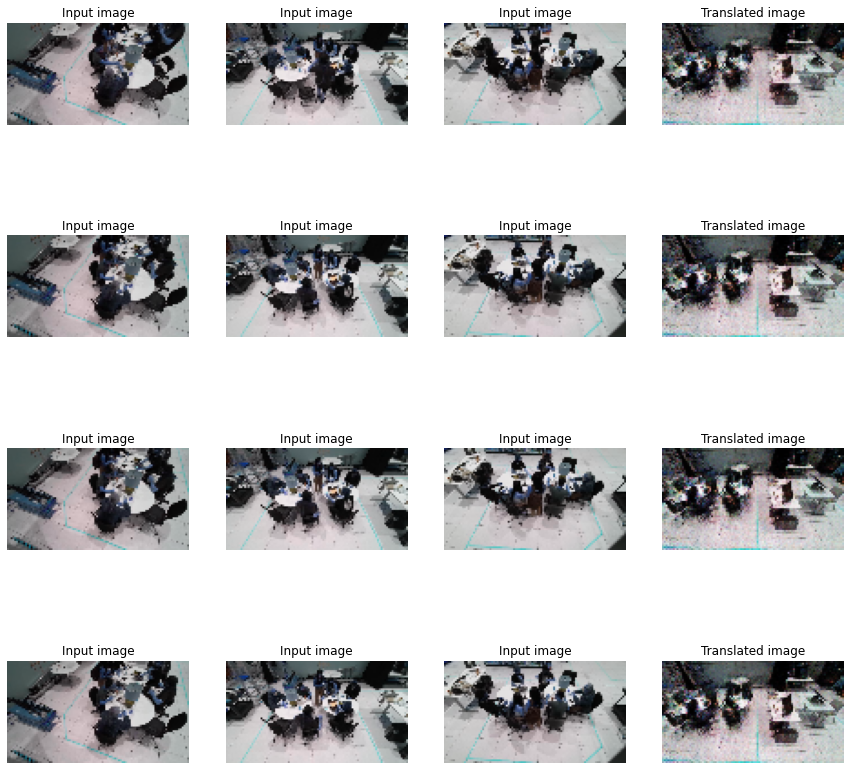

32/32 [==============================] - 22s 702ms/step - X_loss: 1.8209 - Y_loss: 1.8044 - Z_loss: 1.4849 - W_loss: 1.9187 - D_X_loss: 1.3084 - D_Y_loss: 1.3117 - D_Z_loss: 1.3858 - D_W_loss: 1.2637
Epoch 38/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8845 - Y_loss: 1.8005 - Z_loss: 1.5116 - W_loss: 2.0911 - D_X_loss: 1.2384 - D_Y_loss: 1.3471 - D_Z_loss: 1.3928 - D_W_loss: 1.0977

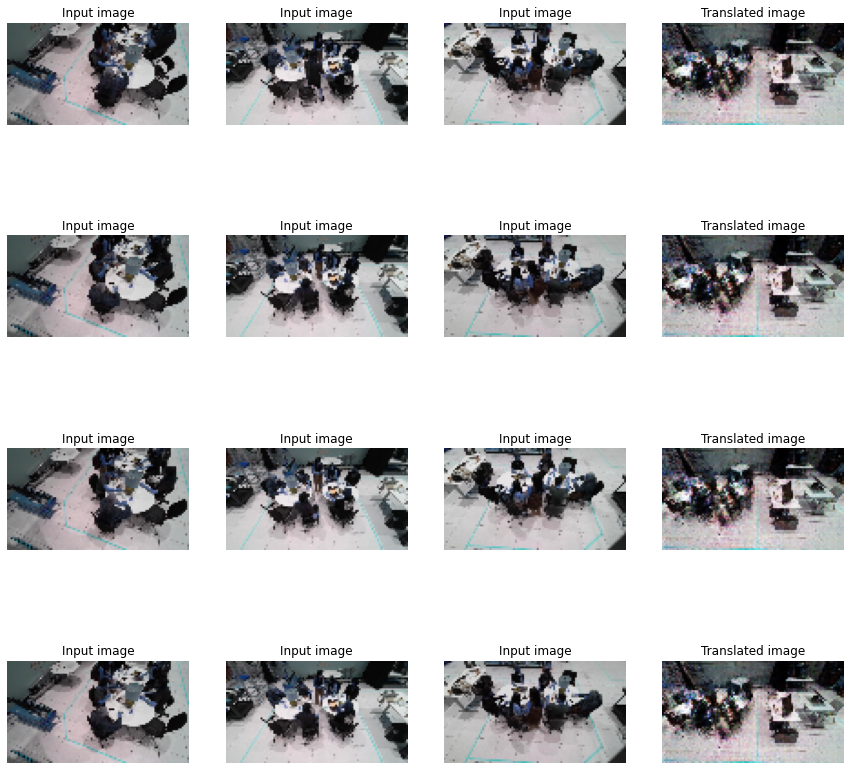

32/32 [==============================] - 22s 703ms/step - X_loss: 1.8814 - Y_loss: 1.7991 - Z_loss: 1.5106 - W_loss: 2.0719 - D_X_loss: 1.2461 - D_Y_loss: 1.3469 - D_Z_loss: 1.3910 - D_W_loss: 1.1163
Epoch 39/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8508 - Y_loss: 1.7969 - Z_loss: 1.4944 - W_loss: 1.8985 - D_X_loss: 1.2974 - D_Y_loss: 1.3437 - D_Z_loss: 1.4254 - D_W_loss: 1.3803

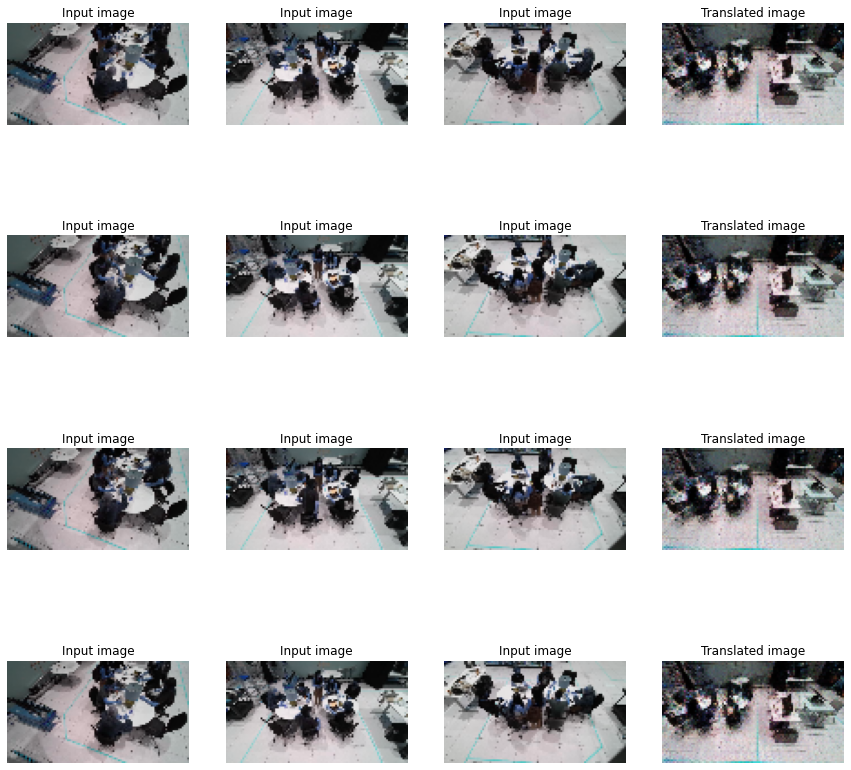

32/32 [==============================] - 22s 699ms/step - X_loss: 1.8503 - Y_loss: 1.7942 - Z_loss: 1.4907 - W_loss: 1.8945 - D_X_loss: 1.2958 - D_Y_loss: 1.3451 - D_Z_loss: 1.4267 - D_W_loss: 1.3858
Epoch 40/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8770 - Y_loss: 1.8240 - Z_loss: 1.5019 - W_loss: 2.0018 - D_X_loss: 1.2061 - D_Y_loss: 1.2730 - D_Z_loss: 1.4034 - D_W_loss: 1.2501

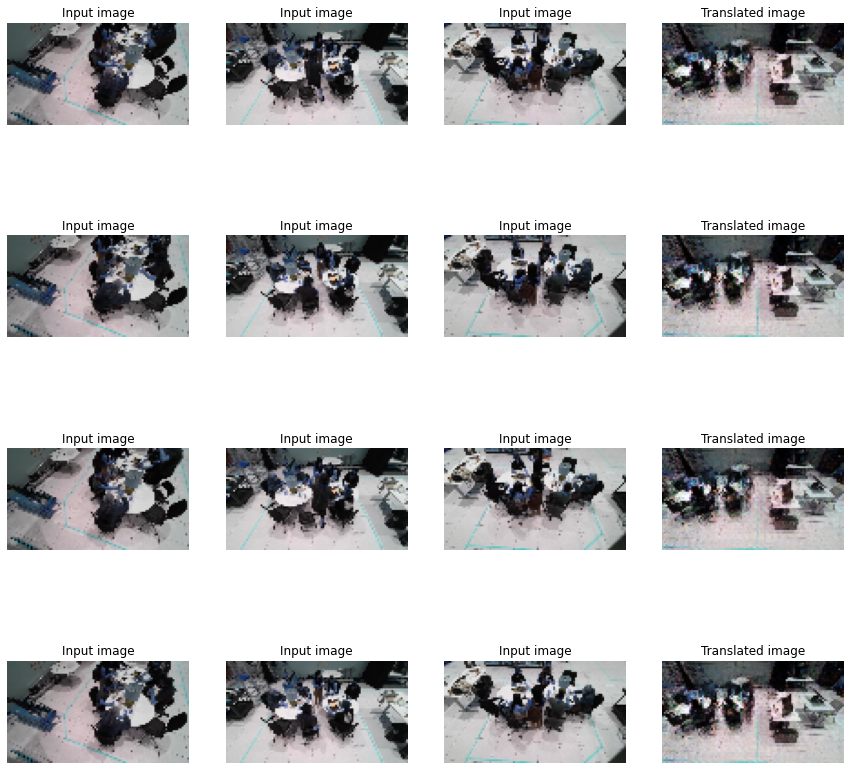

32/32 [==============================] - 22s 700ms/step - X_loss: 1.8770 - Y_loss: 1.8201 - Z_loss: 1.4996 - W_loss: 1.9899 - D_X_loss: 1.1996 - D_Y_loss: 1.2743 - D_Z_loss: 1.4013 - D_W_loss: 1.2559
Epoch 41/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8935 - Y_loss: 1.7594 - Z_loss: 1.4727 - W_loss: 1.9942 - D_X_loss: 1.1738 - D_Y_loss: 1.3355 - D_Z_loss: 1.4125 - D_W_loss: 1.2183

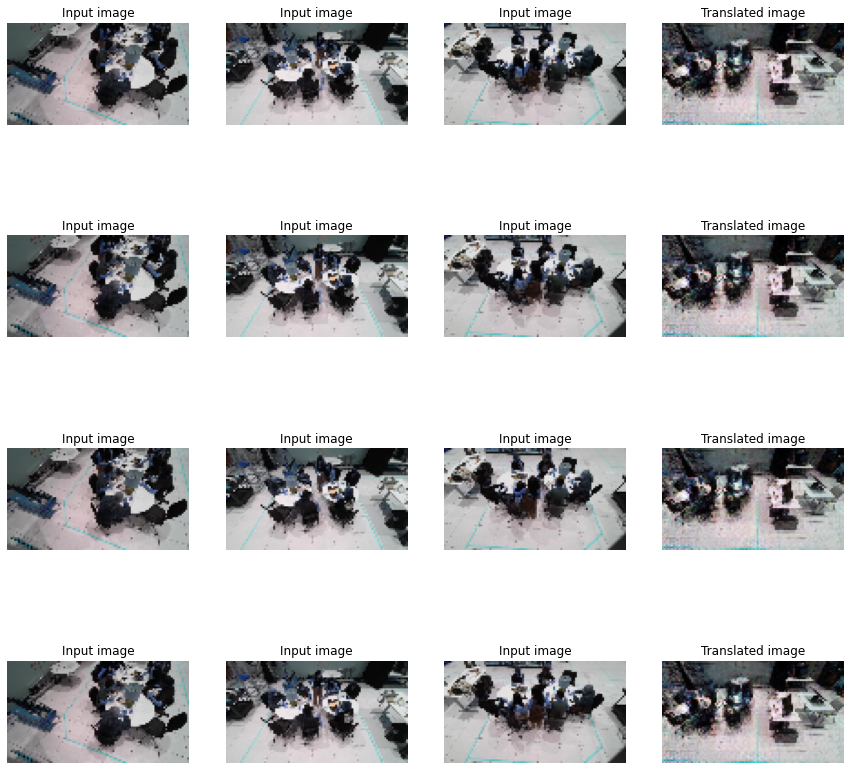

32/32 [==============================] - 22s 698ms/step - X_loss: 1.8924 - Y_loss: 1.7596 - Z_loss: 1.4717 - W_loss: 1.9869 - D_X_loss: 1.1656 - D_Y_loss: 1.3402 - D_Z_loss: 1.4094 - D_W_loss: 1.2193
Epoch 42/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8970 - Y_loss: 1.7394 - Z_loss: 1.4395 - W_loss: 1.8924 - D_X_loss: 1.1921 - D_Y_loss: 1.3177 - D_Z_loss: 1.4141 - D_W_loss: 1.3005

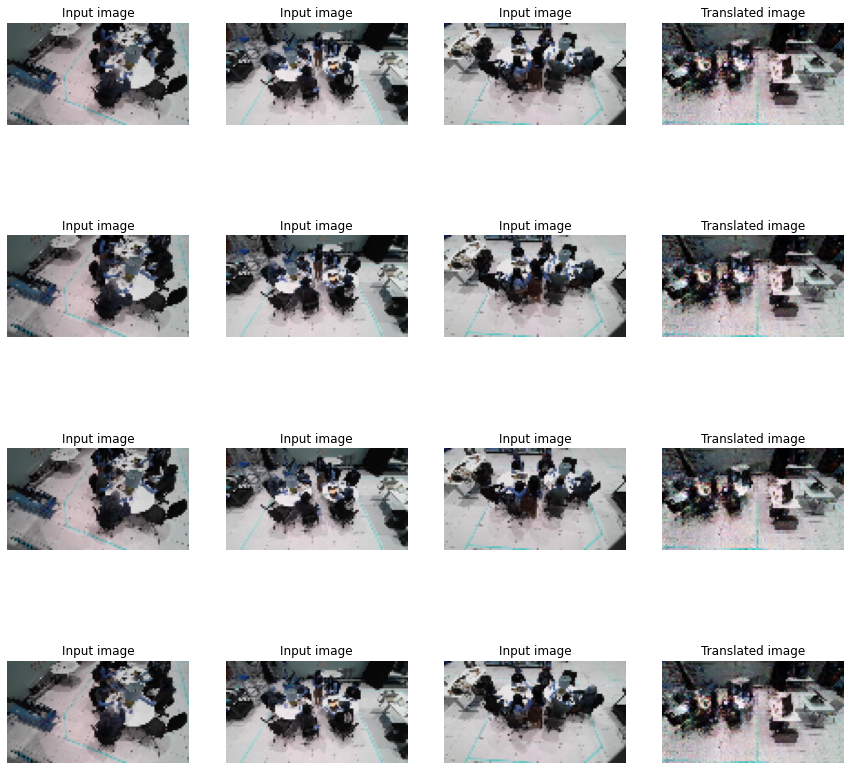

32/32 [==============================] - 22s 704ms/step - X_loss: 1.8986 - Y_loss: 1.7422 - Z_loss: 1.4413 - W_loss: 1.8924 - D_X_loss: 1.1911 - D_Y_loss: 1.3169 - D_Z_loss: 1.4132 - D_W_loss: 1.2950
Epoch 43/50
32/32 [==============================] - ETA: 0s - X_loss: 1.7866 - Y_loss: 1.7552 - Z_loss: 1.4567 - W_loss: 1.8111 - D_X_loss: 1.3309 - D_Y_loss: 1.3341 - D_Z_loss: 1.4222 - D_W_loss: 1.3091

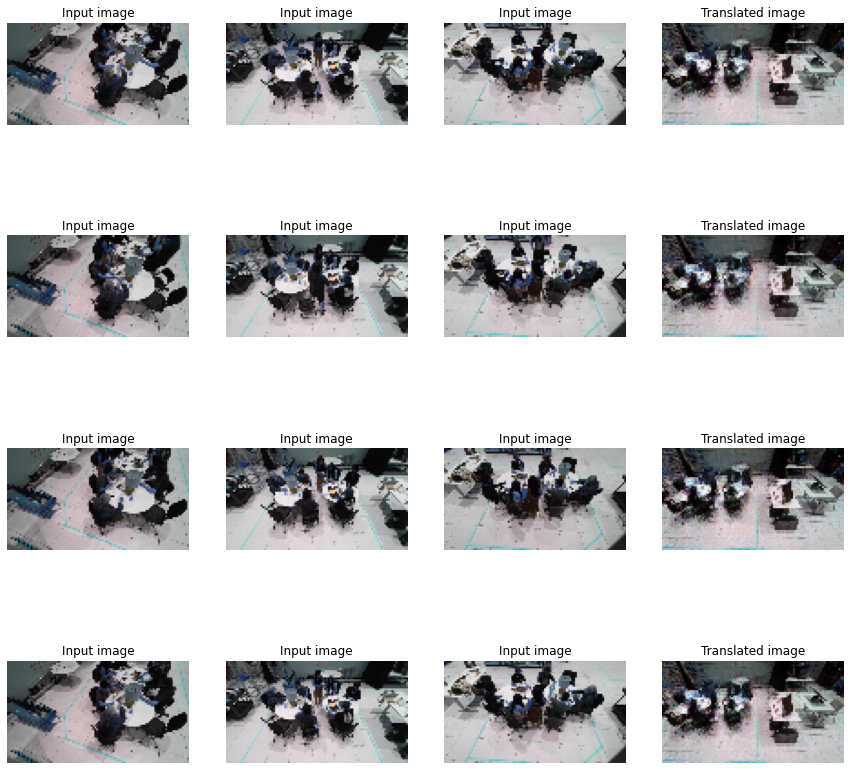

32/32 [==============================] - 22s 703ms/step - X_loss: 1.7896 - Y_loss: 1.7562 - Z_loss: 1.4550 - W_loss: 1.8070 - D_X_loss: 1.3280 - D_Y_loss: 1.3327 - D_Z_loss: 1.4221 - D_W_loss: 1.3149
Epoch 44/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8554 - Y_loss: 1.8097 - Z_loss: 1.4582 - W_loss: 1.9326 - D_X_loss: 1.2021 - D_Y_loss: 1.2792 - D_Z_loss: 1.4042 - D_W_loss: 1.2960

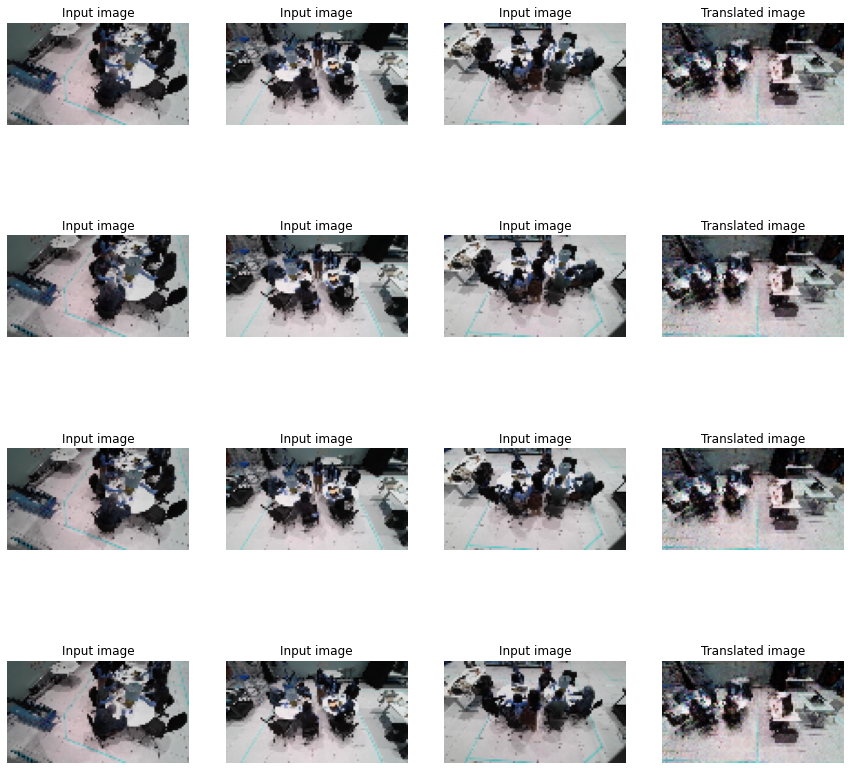

32/32 [==============================] - 22s 704ms/step - X_loss: 1.8526 - Y_loss: 1.8115 - Z_loss: 1.4567 - W_loss: 1.9289 - D_X_loss: 1.2005 - D_Y_loss: 1.2802 - D_Z_loss: 1.4030 - D_W_loss: 1.3030
Epoch 45/50
32/32 [==============================] - ETA: 0s - X_loss: 1.6882 - Y_loss: 1.7086 - Z_loss: 1.4235 - W_loss: 1.8255 - D_X_loss: 1.4032 - D_Y_loss: 1.3368 - D_Z_loss: 1.4257 - D_W_loss: 1.2974

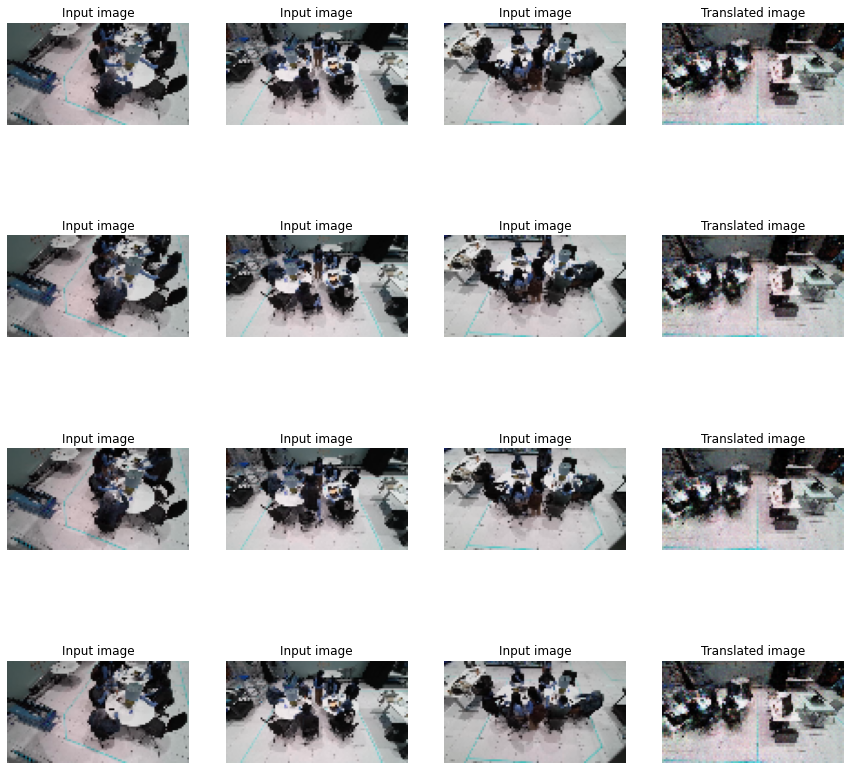

32/32 [==============================] - 22s 703ms/step - X_loss: 1.6947 - Y_loss: 1.7048 - Z_loss: 1.4225 - W_loss: 1.8209 - D_X_loss: 1.4098 - D_Y_loss: 1.3375 - D_Z_loss: 1.4270 - D_W_loss: 1.3011
Epoch 46/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8866 - Y_loss: 1.7581 - Z_loss: 1.4383 - W_loss: 1.9583 - D_X_loss: 1.1313 - D_Y_loss: 1.3223 - D_Z_loss: 1.4009 - D_W_loss: 1.1968

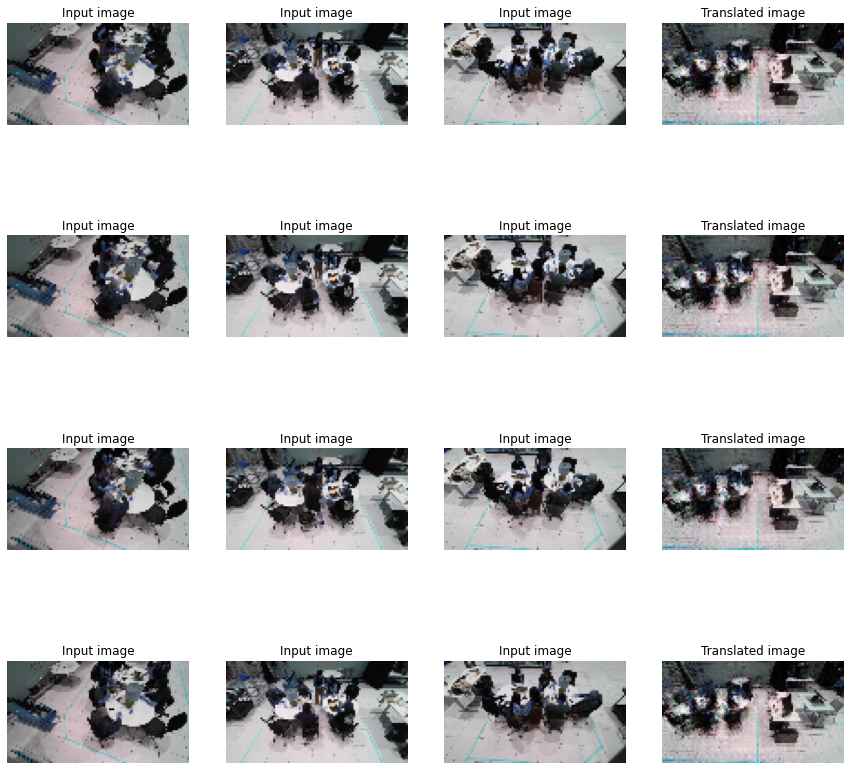

32/32 [==============================] - 24s 748ms/step - X_loss: 1.8820 - Y_loss: 1.7550 - Z_loss: 1.4348 - W_loss: 1.9529 - D_X_loss: 1.1310 - D_Y_loss: 1.3255 - D_Z_loss: 1.4020 - D_W_loss: 1.1944
Epoch 47/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8077 - Y_loss: 1.7659 - Z_loss: 1.4585 - W_loss: 1.8032 - D_X_loss: 1.2774 - D_Y_loss: 1.2871 - D_Z_loss: 1.4288 - D_W_loss: 1.3427

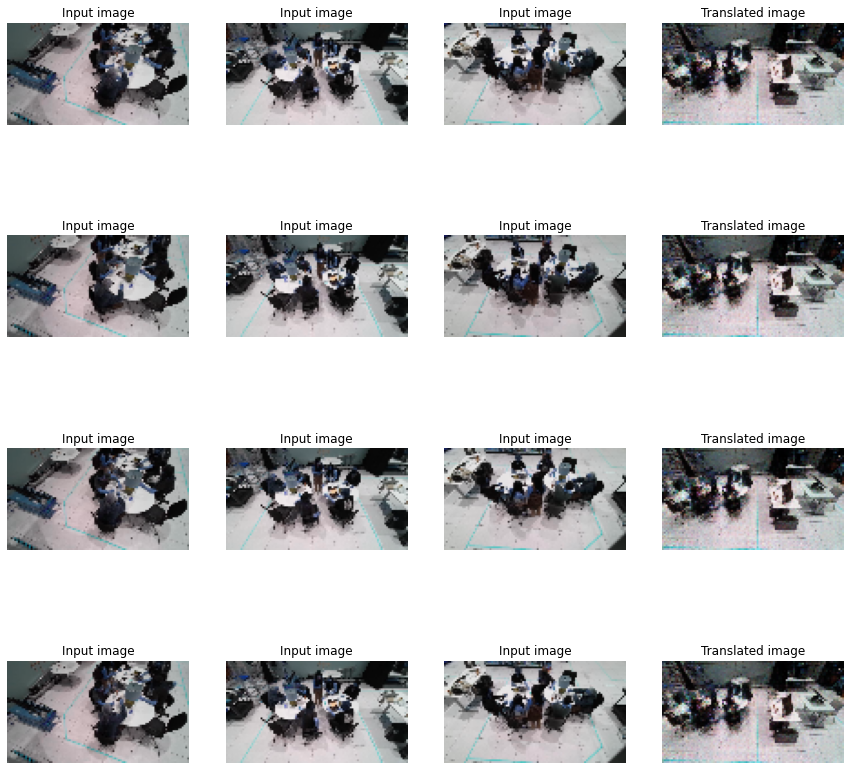

32/32 [==============================] - 22s 703ms/step - X_loss: 1.8053 - Y_loss: 1.7659 - Z_loss: 1.4531 - W_loss: 1.7972 - D_X_loss: 1.2728 - D_Y_loss: 1.2865 - D_Z_loss: 1.4300 - D_W_loss: 1.3437
Epoch 48/50
32/32 [==============================] - ETA: 0s - X_loss: 1.8327 - Y_loss: 1.7493 - Z_loss: 1.4482 - W_loss: 1.8502 - D_X_loss: 1.1625 - D_Y_loss: 1.2553 - D_Z_loss: 1.3461 - D_W_loss: 1.2576

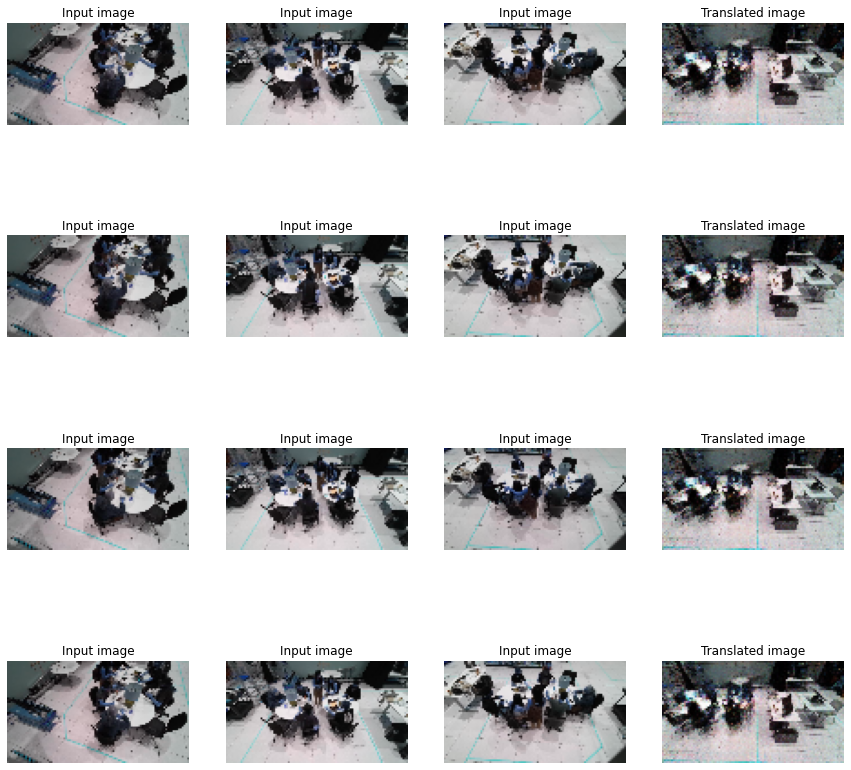

32/32 [==============================] - 22s 703ms/step - X_loss: 1.8286 - Y_loss: 1.7440 - Z_loss: 1.4431 - W_loss: 1.8407 - D_X_loss: 1.1684 - D_Y_loss: 1.2551 - D_Z_loss: 1.3471 - D_W_loss: 1.2592
Epoch 49/50
32/32 [==============================] - ETA: 0s - X_loss: 1.7958 - Y_loss: 1.7536 - Z_loss: 1.4187 - W_loss: 1.8255 - D_X_loss: 1.2339 - D_Y_loss: 1.2615 - D_Z_loss: 1.4496 - D_W_loss: 1.2783

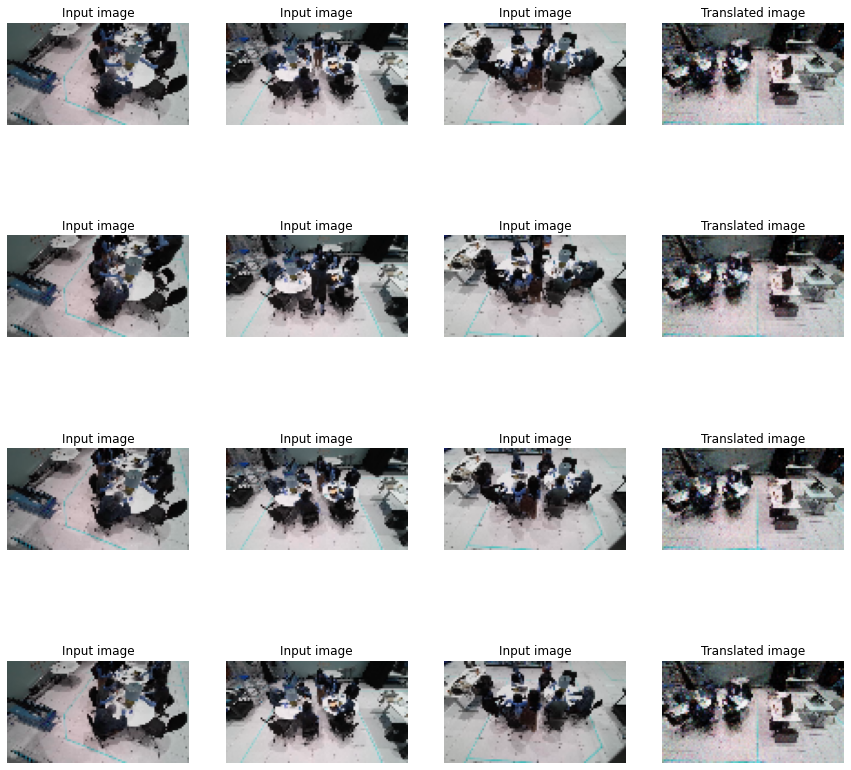

32/32 [==============================] - 22s 702ms/step - X_loss: 1.7964 - Y_loss: 1.7528 - Z_loss: 1.4147 - W_loss: 1.8204 - D_X_loss: 1.2294 - D_Y_loss: 1.2640 - D_Z_loss: 1.4495 - D_W_loss: 1.2856
Epoch 50/50
32/32 [==============================] - ETA: 0s - X_loss: 1.7715 - Y_loss: 1.7157 - Z_loss: 1.4197 - W_loss: 1.8075 - D_X_loss: 1.1846 - D_Y_loss: 1.2616 - D_Z_loss: 1.3956 - D_W_loss: 1.2735

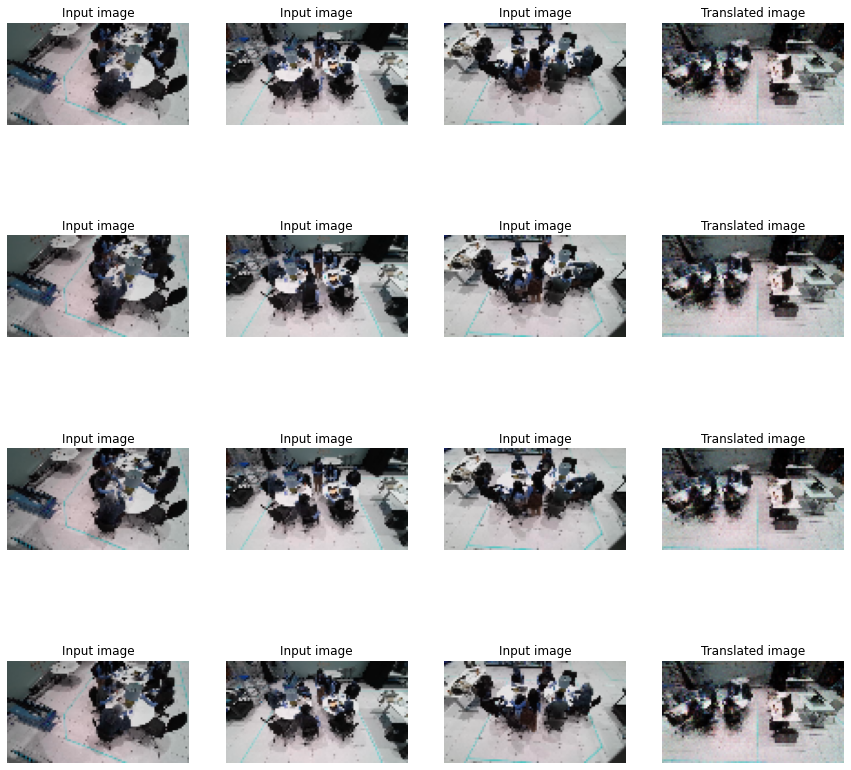

32/32 [==============================] - 22s 704ms/step - X_loss: 1.7672 - Y_loss: 1.7153 - Z_loss: 1.4200 - W_loss: 1.8037 - D_X_loss: 1.1878 - D_Y_loss: 1.2623 - D_Z_loss: 1.3971 - D_W_loss: 1.2765


In [ ]:
# Loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()
binary_loss_fn = keras.losses.BinaryCrossentropy(from_logits=False)
categorical_loss_fn = keras.losses.CategoricalCrossentropy(from_logits=False)
# Define the loss function for the generators
def generator_loss_fn(fake, fake_label, true_label):
    #fake_loss = adv_loss_fn(tf.ones_like(fake), fake)
    fake_loss = binary_loss_fn(tf.ones_like(fake), fake)
    fake_label_loss = categorical_loss_fn(true_label, fake_label)
    return fake_label_loss + fake_loss #L_C - L_S


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake, real_label, fake_label, true_label):
    #real_loss = adv_loss_fn(tf.ones_like(real), real)
    #fake_loss = adv_loss_fn(tf.zeros_like(fake), fake)
    real_loss = binary_loss_fn(tf.ones_like(real), real)
    fake_loss = binary_loss_fn(tf.zeros_like(fake), fake)

    real_label_loss = categorical_loss_fn(true_label, real_label) 
    fake_label_loss = categorical_loss_fn(true_label, fake_label)
    return (real_loss + fake_loss) + (real_label_loss + fake_label_loss) #L_S + L_C#* 0.5


# Create cycle gan model
'''
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)
'''
cycle_gan_model = CycleGan(
    generator_X=gen_X,  
    discriminator_X=disc_X 
)
    
# Compile the model
'''
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
'''
cycle_gan_model.compile(
    gen_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Callbacks
plotter = GANMonitor()
#checkpoint_filepath = "./model_checkpoints/cyclegan_checkpoints.{epoch:03d}"
checkpoint_filepath = "/content/drive/MyDrive/Research/model_checkpoints/cyclegan_checkpoints.{epoch:03d}"
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath
)

# Here we will train the model for just one epoch as each epoch takes around
# 7 minutes on a single P100 backed machine.
cycle_gan_model.fit(
    tf.data.Dataset.zip((train_angles_3, train_angles_1, train_labels)),
    epochs=50,
    #callbacks=[plotter, model_checkpoint_callback],
    callbacks=[plotter]
)

Test the performance of the model.

In [ ]:

# This model was trained for 90 epochs. We will be loading those weights
# here. Once the weights are loaded, we will take a few samples from the test
# data and check the model's performance.

In [ ]:

# Load the checkpoints
#weight_file = "./saved_checkpoints/cyclegan_checkpoints.090"
#cycle_gan_model.load_weights(weight_file).expect_partial()
#print("Weights loaded successfully")

#_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(zip(test_angles_3, test_angles_1)):
    wxy,z = img[0],img[1]
    
    real_w,real_x,real_y = wxy[:,0,:,:,:],wxy[:,1,:,:,:],wxy[:,2,:,:,:]
    input1 = tf.add_n([real_w,real_x,real_y])
    prediction = cycle_gan_model.gen(input1, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8) # predicted image
    
    print(img[0].shape)
    print(img[1].shape)
    print('z:',z[:,0,...].shape)
    print(prediction.shape)
    print(input1.shape)
    
    img = (z[:,0,...] * 127.5 + 127.5)[0].numpy().astype(np.uint8) # real image
   
    prediction = keras.preprocessing.image.array_to_img(prediction)
    real = keras.preprocessing.image.array_to_img(img)
    prediction.save("/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs/mult_predicted_img_{i}.jpg".format(i=i))
    real.save("/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs/mult_real_img_{i}.jpg".format(i=i))
    
#plt.tight_layout()
#plt.show()


(32, 3, 56, 100, 3)
(32, 1, 56, 100, 3)
z: (32, 56, 100, 3)
(56, 100, 3)
(32, 56, 100, 3)
(32, 3, 56, 100, 3)
(32, 1, 56, 100, 3)
z: (32, 56, 100, 3)
(56, 100, 3)
(32, 56, 100, 3)
(32, 3, 56, 100, 3)
(32, 1, 56, 100, 3)
z: (32, 56, 100, 3)
(56, 100, 3)
(32, 56, 100, 3)
(32, 3, 56, 100, 3)
(32, 1, 56, 100, 3)
z: (32, 56, 100, 3)
(56, 100, 3)
(32, 56, 100, 3)
(32, 3, 56, 100, 3)
(32, 1, 56, 100, 3)
z: (32, 56, 100, 3)
(56, 100, 3)
(32, 56, 100, 3)
(32, 3, 56, 100, 3)
(32, 1, 56, 100, 3)
z: (32, 56, 100, 3)
(56, 100, 3)
(32, 56, 100, 3)
(8, 3, 56, 100, 3)
(8, 1, 56, 100, 3)
z: (8, 56, 100, 3)
(56, 100, 3)
(8, 56, 100, 3)


In [ ]:
import glob
from PIL import Image

In [ ]:
# filepaths
#fp_in = "/path/to/image_*.png"
#fp_in = "/content/drive/MyDrive/Research/CycleGAN_imgs/generated_img_0_*.png"
fp_in = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs/mult_predicted_img_*.png"
#fp_in = "/content/predicted_img_*.png"
#fp_out = "/path/to/image.gif"
fp_out = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_predicted_mult_3to1.gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=500, loop=0)

In [ ]:
# filepaths
#fp_in = "/path/to/image_*.png"
#fp_in = "/content/drive/MyDrive/Research/CycleGAN_imgs/generated_img_0_*.png"
fp_in = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs/mult_real_img_*.png"
#fp_in = "/content/predicted_img_*.png"
#fp_out = "/path/to/image.gif"
fp_out = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_real_mult_3to1.gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=500, loop=0)

In [ ]:
from IPython.display import display, Image
A = Image(open('/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_predicted_mult_3to1.gif','rb').read())
B = Image(open('/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_real_mult_3to1.gif','rb').read())

In [ ]:
display(A)
display(B)

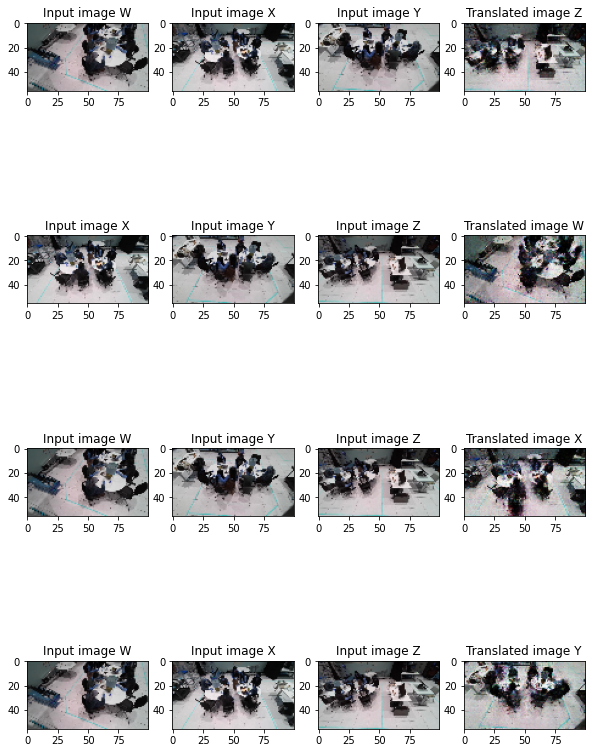

In [ ]:
_, ax = plt.subplots(4, 4, figsize=(10, 15))
for i, img in enumerate(zip(test_angles_3, test_angles_1)):
    wxy,Z = img[0],img[1]
    
    W,X,Y,Z = wxy[:,0,:,:,:],wxy[:,1,:,:,:],wxy[:,2,:,:,:],Z[:,0,...]
    #input1 = tf.add_n([real_w,real_x,real_y])

    #W,X,Y,Z = img[0][0],img[0][1],img[0][2],img[1][0]
    input1 = tf.add_n([W,X,Y]) # W,X,Y -> Z
    
    input2 = tf.add_n([X,Y,Z]) # X,Y,Z -> W
    
    input3 = tf.add_n([W,Y,Z]) # W,Y,Z -> X
    
    input4 = tf.add_n([W,X,Z]) # W,X,Z -> Y
    
    #print(input1.shape)
    #print(img[0].shape)
    prediction1 = cycle_gan_model.gen(input1, training=False)[0].numpy()
    prediction2 = cycle_gan_model.gen(input2, training=False)[0].numpy()
    prediction3 = cycle_gan_model.gen(input3, training=False)[0].numpy()
    prediction4 = cycle_gan_model.gen(input4, training=False)[0].numpy()
    #print(img[0].shape)
    #print(img[1].shape)
    prediction1 = (prediction1 * 127.5 + 127.5).astype(np.uint8) # predicted image
    prediction2 = (prediction2 * 127.5 + 127.5).astype(np.uint8) # predicted image
    prediction3 = (prediction3 * 127.5 + 127.5).astype(np.uint8) # predicted image
    prediction4 = (prediction4 * 127.5 + 127.5).astype(np.uint8) # predicted image
    X = (X[0] * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    Y = (Y[0] * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    Z = (Z[0] * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    W = (W[0] * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    
    ax[0, 0].imshow(W)
    ax[0, 1].imshow(X)
    ax[0, 2].imshow(Y)
    ax[0, 3].imshow(prediction1)
    ax[0, 0].set_title("Input image W")
    ax[0, 1].set_title("Input image X")
    ax[0, 2].set_title("Input image Y")
    ax[0, 3].set_title("Translated image Z")

    ax[1, 0].imshow(X)
    ax[1, 1].imshow(Y)
    ax[1, 2].imshow(Z)
    ax[1, 3].imshow(prediction2)
    ax[1, 0].set_title("Input image X")
    ax[1, 1].set_title("Input image Y")
    ax[1, 2].set_title("Input image Z")
    ax[1, 3].set_title("Translated image W")

    ax[2, 0].imshow(W)
    ax[2, 1].imshow(Y)
    ax[2, 2].imshow(Z)
    ax[2, 3].imshow(prediction3)
    ax[2, 0].set_title("Input image W")
    ax[2, 1].set_title("Input image Y")
    ax[2, 2].set_title("Input image Z")
    ax[2, 3].set_title("Translated image X")
    #ax[i, 0].axis("off")
    #ax[i, 1].axis("off")

    ax[3, 0].imshow(W)
    ax[3, 1].imshow(X)
    ax[3, 2].imshow(Z)
    ax[3, 3].imshow(prediction4)
    ax[3, 0].set_title("Input image W")
    ax[3, 1].set_title("Input image X")
    ax[3, 2].set_title("Input image Z")
    ax[3, 3].set_title("Translated image Y")
    
plt.show()
plt.close()